# Installation

In [1]:
import os

cur_dir = os.getcwd()
print(cur_dir)
if "research" in cur_dir:
    new_dir = os.path.dirname(cur_dir)
    os.chdir(new_dir)
    print(new_dir)

/Users/dmitrii.koriakov/PycharmProjects/car-project-monorepo/research
/Users/dmitrii.koriakov/PycharmProjects/car-project-monorepo


In [2]:
import os
import json
import time
import uuid
from concurrent.futures import ThreadPoolExecutor
from enum import Enum
from typing import Tuple, List, Dict
from IPython.display import Markdown, display
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from libs.python.utils.request_utils import send_request
from copy import deepcopy
import matplotlib.colors as mcolors
import colorsys

MAX_WORKERS = 32
ENDPOINT_TO_AGENT = "http://localhost:8096/agent/process_user_message"
ENDPOINT_TO_CALC_SCORE = "http://localhost:8096/evaluation/score_calc_pipeline"

LINE_DASH_LIST = ['solid', 'dot', 'dash', 'longdash', 'dashdot', 'longdashdot']

In [3]:
import redis
from dotenv import load_dotenv

load_dotenv("research/.env")

True

In [4]:
redis_client = redis.Redis(
    host=os.getenv("REDIS_HOST", "localhost"),
    port=int(os.getenv("REDIS_PORT", 6380)),
    db=int(os.getenv("REDIS_DB_PUB_SUB", 2)),
    password=os.getenv("REDIS_PASSWORD_LLM", "redispassword"),
)

In [5]:
class ScaleType(Enum):
    scale_min_max = "scale_min_max"
    scale_0_1 = "scale_0_1"
    scale_0_5 = "scale_0_5"
    scale_minus5_5 = "scale_minus5_5"
    scale_minus1_1 = "scale_minus1_1"


scale_type_map = {
    ScaleType.scale_min_max: (None, None),
    ScaleType.scale_0_1: (0, 1),
    ScaleType.scale_0_5: (0, 5),
    ScaleType.scale_minus5_5: (-5, 5),
    ScaleType.scale_minus1_1: (-1, 1),
}


In [6]:
# Hex colors corresponding to 'tab:' colors from matplotlib
TAB_COLORS = ['#1f77b4', '#2ca02c', '#d62728', '#ff7f0e', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']

# Custom names for the configurations in the legend
CUSTOM_LEGEND_NAMES_MAP = {
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": 'Vector DB',
        "graphrag_test_gpt4o_mini": 'GraphRAG',
        "base_llm_sys_prompt_gpt4o_mini": 'Base LLM',
}
# Custom binning offsets for each configuration
BIN_STARTS = [1.0, 1.1, 1.2]


# Downloading data

## Scenario_1. Dialogs when Agent asks User and provide options in the end.
## Scenario_2. Dialogs for the consistency measure (the user's questions are slightly different)

In [7]:
# dataset_prefix = "dataset"
# dataset_prefix = "dataset2"
dataset_prefix = "results_prev-v7_calc_all_metrics_return_all_scores_temp_08"
# dataset_prefix = "results_prev-v9_calc_all_metrics_return_all_scores_temp_04"
# dataset_prefix = "results_prev-v8_calc_all_metrics_return_all_scores_temp_00"

df_scenario_1 = pd.read_csv(f"research/{dataset_prefix}/dataset_template_scenario_1.csv")
df_scenario_1_consistency = pd.read_csv(f"research/{dataset_prefix}/dataset_template_scenario_1_consistency.csv")
df_scenario_2 = pd.read_csv(f"research/{dataset_prefix}/dataset_template_scenario_2_questions_inventory.csv")
df_scenario_2_consistency = pd.read_csv(
    f"research/{dataset_prefix}/dataset_template_scenario_2_questions_inventory_consistency.csv")

In [8]:
df_scenario_1.head()

,dialog_name_0,dialog_name_1,dialog_name_2,dialog_name_3,dialog_name_4
0,"{""key"": ""value""}","{""key"": ""value""}","{""key"": ""value""}","{""key"": ""value""}","{""key"": ""value""}"
1,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...
2,HUMAN: Big and powerful,HUMAN: The most trendy car,HUMAN: Car for traveling,"HUMAN: I’m looking for my first car, cheap and...","HUMAN: Basic cheap enough car, which I will ea..."
3,AI: Great! It sounds like you're interested in...,AI: Trends in cars can vary greatly depending ...,AI: Great! A car for traveling can mean differ...,AI: That's great! Buying your first car is an ...,AI: Thank you for sharing your preferences. It...
4,HUMAN: Truck,HUMAN: Luxury,HUMAN: For my hobby - it’s riding a bicycle an...,HUMAN: Used car. Less than 10 000,HUMAN: Sedan


In [9]:
df_scenario_1_consistency.head()

,dialog_name_0,dialog_name_1,dialog_name_2,dialog_name_3,dialog_name_4
0,"{""key"": ""value""}","{""key"": ""value""}","{""key"": ""value""}","{""key"": ""value""}","{""key"": ""value""}"
1,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...
2,HUMAN: Large and powerful,HUMAN: The most fashionable car,HUMAN: Car for traveling,"HUMAN: I’m looking for my 1st car, cheap and e...","HUMAN: Basic cheap enough car, which I'll easi..."
3,AI: Great! It sounds like you're interested in...,AI: Trends in cars can vary greatly depending ...,AI: Great! A car for traveling can mean differ...,AI: That's great! Buying your first car is an ...,AI: Thank you for sharing your preferences. It...
4,HUMAN: Truck,HUMAN: Luxury,HUMAN: For my hobby - it's biking and fishing,HUMAN: Used car. Less than 10k,HUMAN: Sedan


In [10]:
df_scenario_2.head()

,dialog_name_0,dialog_name_1,dialog_name_2,dialog_name_3,dialog_name_4,dialog_name_5,dialog_name_6,dialog_name_7,dialog_name_8,dialog_name_9,...,dialog_name_23,dialog_name_24,dialog_name_25,dialog_name_26,dialog_name_27,dialog_name_28,dialog_name_29,dialog_name_30,dialog_name_31,dialog_name_32
0,"{""q"": ""What is the reliability rating of the c...","{""q"": ""How fast does the car accelerate from 0...","{""q"": ""What is the fuel efficiency of the car ...","{""q"": ""How spacious is the interior cabin?"", ""...","{""q"": ""Does the car have enough space for thre...","{""q"": ""What safety features does the car inclu...","{""q"": ""Does the car have enough space for thre...","{""q"": ""What is the horsepower of the engine?"",...","{""q"": ""How comfortable are the seats in the ca...","{""q"": ""What is the car's maintenance cost?"", ""...",...,"{""q"": ""How fast does the car accelerate from 0...","{""q"": ""What is the fuel efficiency of the car ...","{""q"": ""How spacious is the interior cabin?"", ""...","{""q"": ""Does the car have enough space for thre...","{""q"": ""What safety features does the car inclu...","{""q"": ""Does the car have enough space for thre...","{""q"": ""What is the horsepower of the engine?"",...","{""q"": ""How comfortable are the seats in the ca...","{""q"": ""What is the car's maintenance cost?"", ""...","{""q"": ""How well does the car handle in differe..."
1,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...
2,HUMAN: What is the reliability rating of the c...,HUMAN: How fast does the car accelerate from 0...,HUMAN: What is the fuel efficiency of the car ...,HUMAN: How spacious is the interior cabin? BMW...,HUMAN: Does the car have enough space for thre...,HUMAN: What safety features does the car inclu...,HUMAN: Does the car have enough space for thre...,HUMAN: What is the horsepower of the engine? B...,HUMAN: How comfortable are the seats in the ca...,HUMAN: What is the car's maintenance cost? BMW...,...,HUMAN: How fast does the car accelerate from 0...,HUMAN: What is the fuel efficiency of the car ...,HUMAN: How spacious is the interior cabin? For...,HUMAN: Does the car have enough space for thre...,HUMAN: What safety features does the car inclu...,HUMAN: Does the car have enough space for thre...,HUMAN: What is the horsepower of the engine? F...,HUMAN: How comfortable are the seats in the ca...,HUMAN: What is the car's maintenance cost? For...,HUMAN: How well does the car handle in differe...


In [11]:
df_scenario_2_consistency.head()

,dialog_name_0,dialog_name_1,dialog_name_2,dialog_name_3,dialog_name_4,dialog_name_5,dialog_name_6,dialog_name_7,dialog_name_8,dialog_name_9,...,dialog_name_23,dialog_name_24,dialog_name_25,dialog_name_26,dialog_name_27,dialog_name_28,dialog_name_29,dialog_name_30,dialog_name_31,dialog_name_32
0,"{""q"": ""What is the reliability rating of the c...","{""q"": ""How fast does the car accelerate from 0...","{""q"": ""What is the fuel efficiency of the car ...","{""q"": ""How spacious is the interior cabin?"", ""...","{""q"": ""Does the car have enough space for thre...","{""q"": ""What safety features does the car inclu...","{""q"": ""Does the car have enough space for thre...","{""q"": ""What is the horsepower of the engine?"",...","{""q"": ""How comfortable are the seats in the ca...","{""q"": ""What is the car's maintenance cost?"", ""...",...,"{""q"": ""How fast does the car accelerate from 0...","{""q"": ""What is the fuel efficiency of the car ...","{""q"": ""How spacious is the interior cabin?"", ""...","{""q"": ""Does the car have enough space for thre...","{""q"": ""What safety features does the car inclu...","{""q"": ""Does the car have enough space for thre...","{""q"": ""What is the horsepower of the engine?"",...","{""q"": ""How comfortable are the seats in the ca...","{""q"": ""What is the car's maintenance cost?"", ""...","{""q"": ""How well does the car handle in differe..."
1,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...,AI: I’m you personal car buying assistant. I w...
2,HUMAN: What is the dependability score of the ...,HUMAN: How fast does the BMW 4 Series 430d acc...,HUMAN: What is the BMW 4 Series 430d's fuel ef...,HUMAN: How spacious is the BMW 4 Series 430d's...,HUMAN: Can the trunk of the BMW 4 Series 430d ...,HUMAN: What safety features are equipped in th...,HUMAN: Does the BMW 4 Series 430d have enough ...,HUMAN: What is the engine power of the BMW 4 S...,HUMAN: How relaxing are the seats in the BMW 4...,HUMAN: What are the upkeep costs for the BMW 4...,...,HUMAN: How fast does the Ford Fiesta ST-Line X...,HUMAN: What is the Ford Fiesta ST-Line X Editi...,HUMAN: How spacious is the Ford Fiesta ST-Line...,HUMAN: Can the trunk of the Ford Fiesta ST-Lin...,HUMAN: What safety features are equipped in th...,HUMAN: Does the Ford Fiesta ST-Line X Edition ...,HUMAN: What is the engine power of the Ford Fi...,HUMAN: How relaxing are the seats in the Ford ...,HUMAN: What are the upkeep costs for the Ford ...,HUMAN: How does the Ford Fiesta ST-Line X Edit...


In [12]:

def get_dialog_content_metadata_from_column(df, column):
    dialog_content = []

    metadata = dict()
    for idx, row in df[[column]].iterrows():
        if idx == 0:
            metadata = json.loads(row.item())
            # display(metadata)

        elif not pd.isna(row.item()):
            content_split = row.item().split(":")
            type_message = content_split[0]
            content = content_split[1].strip()
            assert type_message in ("AI", "HUMAN"), f"type_message[{type_message}] should be in ('AI', 'HUMAN');"
            # display(f"type_message: <{type_message}>")
            # display(f"Content: <{content}>")
            dialog_content.append({
                "type_message": type_message,
                "content": content.replace("Use tool go to internet!", ""),
            })

    # dialog_content.append({
    #     "type_message": "HUMAN",
    #     "content": "USE TOOL AND PROVIDE ME ANSWER TO MY QUESTION RIGHT NOW!!!",
    # })

    return dialog_content, metadata


def get_dialogs_content(df, df_list_of_consistency):
    df_json = dict()
    for column in df.columns:
        # display(column)
        # display(df_scenario_1[[column]])

        dialog_content, metadata = get_dialog_content_metadata_from_column(df, column=column)

        list_of_dialogs_of_consistency = []
        for df_of_consistency in df_list_of_consistency:
            dialog_content_consistency, metadata_consistency = get_dialog_content_metadata_from_column(
                df_of_consistency, column=column)
            list_of_dialogs_of_consistency.append({
                "dialog_content": dialog_content_consistency,
                "metadata": metadata_consistency,
            })

        df_json[column] = {"dialog_content": dialog_content,
                           "list_of_dialogs_of_consistency": list_of_dialogs_of_consistency, "metadata": metadata}

    return df_json


In [13]:
df_scenario_1_json = get_dialogs_content(df_scenario_1, df_list_of_consistency=[df_scenario_1_consistency, ])

In [14]:
df_scenario_2_json_ = get_dialogs_content(df_scenario_2, df_list_of_consistency=[df_scenario_2_consistency, ])

In [15]:
df_scenario_2_json = dict()
for dialog_name in df_scenario_2_json_:
    df_scenario_2_json[f"qa_inv_{dialog_name}"] = df_scenario_2_json_[dialog_name]

#### Get Agent results 

In [16]:
def sliding_window(lst, window_size):
    """
    Generates sliding windows of a specified size from a list.
    
    :param lst: The input list from which to generate windows.
    :param window_size: The size of each window.
    :return: A generator yielding each window.
    """
    for i in range(len(lst) - window_size + 1):
        yield lst[i:i + window_size]

In [17]:
def message_handler(message):
    pass
    # try:
    #     data = json.loads(message['data'].decode('utf8'))
    #     event = data.get('event')
    #     print(
    #         f"Received message: \n{json.dumps(event, indent=2, ensure_ascii=False)}\n\n{'=' * 100}"
    #     )
    # except Exception as e:
    #     print(f"Error handling message: {e}")


TIMEOUT_LISTEN_FRO_MESSAGES = 360.


def listen_for_messages(channel, config_preset_name: str = None):
    st = time.time()

    pubsub = redis_client.pubsub()

    # pubsub.subscribe(**{channel: message_handler})
    pubsub.subscribe(channel)
    print(f"[{channel}] Subscribed\n")

    response = None
    agent_output_tool_empty = False
    for message in pubsub.listen():
        # print(message)
        if message["type"] == "message":
            try:
                data = json.loads(message["data"])
                event = data.get('event')

                print(f"[{channel}] EVENT: {event.get('status')}; MESSAGE: {event.get('message')}\n")

                response = data.get("response")

                if event and event.get("status") == "SUCCESS":
                    print(f"[{channel}] !!!STATUS:{event.get('status')}: BREAK!!!\n")
                    # print("SUCCESS status received")
                    if config_preset_name is not None:
                        if "base_llm" not in config_preset_name:
                            if len(response.get("agent_output_tool", [])) == 0:
                                agent_output_tool_empty = True
                                print(f"[{channel}] !!!AssertionError: len(response.get('agent_output_tool')) == 0\n")
                            # else:
                            #     print(f"[{channel}] Response: {response}")
                    break

                elif event and event.get("status") == "FAILED":
                    print(f"[{channel}] !!!STATUS:{event.get('status')}: BREAK!!!\n")
                    break

                if time.time() - st > TIMEOUT_LISTEN_FRO_MESSAGES:
                    print(f"[{channel}] !!!TIMEOUT: {time.time() - st > TIMEOUT_LISTEN_FRO_MESSAGES}; BREAK!!!\n")
                    break

            except Exception as e:
                print(f"[{channel}] Error processing message: {e}\n")

    pubsub.unsubscribe(channel)
    print(f"[{channel}] Unsubscribed\n")
    return response, channel, agent_output_tool_empty

In [18]:
def send_task(dialog_content, config_preset_name, pubsub_channel_name):
    request_data = {
        "user_id": "string",
        "dialog_content": dialog_content,
        "dialog_id": "string",
        "config_preset_name": config_preset_name,
        "return_agent_full_executed_prompt": True,
        "return_agent_tool_output": True,
        "as_task": True,
        "pubsub_channel_name": pubsub_channel_name,
    }
    response = send_request(request_data, endpoint=ENDPOINT_TO_AGENT)
    response_json = response.json()

    return response_json


In [19]:
def add_results(df_json_, config_preset_name):
    df_json = deepcopy(df_json_)

    pubsub_channel_names = dict()
    for dialog_name_i, dialog_name in enumerate(tqdm(df_json, desc="Sending `main` dialog agent exe tasks...")):
        dialog_content = df_json[dialog_name]["dialog_content"]
        pubsub_channel_name = f"n_{dialog_name_i}_{dialog_name}__{uuid.uuid4()}"
        pubsub_channel_names[pubsub_channel_name] = {
            "dialog_name": dialog_name,
            "main_dialog": True,
            "start_task_request_data": (dialog_content, config_preset_name, pubsub_channel_name)
        }

        for df_json_consist_i in range(len(df_json[dialog_name]["list_of_dialogs_of_consistency"])):
            df_json_consist = df_json[dialog_name]["list_of_dialogs_of_consistency"][
                df_json_consist_i]
            dialog_content_consist = df_json_consist["dialog_content"]

            pubsub_channel_name = f"n_{dialog_name_i}_{dialog_name}__consist_n_{df_json_consist_i}__{uuid.uuid4()}"
            pubsub_channel_names[pubsub_channel_name] = {
                "dialog_name": dialog_name,
                "main_dialog": False,
                "df_json_consist_i": df_json_consist_i,
                "start_task_request_data": (dialog_content_consist, config_preset_name, pubsub_channel_name),
            }

    # with ThreadPoolExecutor(max_workers=1) as executor:

    #     futures = []
    #     agent_output_tool_empties = []
    #     for pubsub_channel_name in pubsub_channel_names:
    #         futures.append(executor.submit(listen_for_messages, pubsub_channel_name, config_preset_name))

    #         dialog_content_consist, config_preset_name, pubsub_channel_name = pubsub_channel_names[pubsub_channel_name][
    #             "start_task_request_data"]
    #         send_task(dialog_content_consist, config_preset_name, pubsub_channel_name)

    #     for future in tqdm(futures, desc="Processing results from listen_for_messages..."):
    #         response, channel_from_listener, agent_output_tool_empty = future.result()
    #         agent_output_tool_empties.append(agent_output_tool_empty)
    #         pubsub_channel_names[channel_from_listener]["response"] = response

    for pubsub_channel_names_window in tqdm(sliding_window(list(pubsub_channel_names.keys()), window_size=1),
                                            desc="batch_process"):

        with ThreadPoolExecutor(max_workers=1) as executor:

            futures = []
            agent_output_tool_empties = []
            for pubsub_channel_name in pubsub_channel_names_window:
                futures.append(executor.submit(listen_for_messages, pubsub_channel_name, config_preset_name))

                dialog_content_consist, config_preset_name, pubsub_channel_name = \
                pubsub_channel_names[pubsub_channel_name][
                    "start_task_request_data"]
                send_task(dialog_content_consist, config_preset_name, pubsub_channel_name)

            for future in tqdm(futures, desc="Processing results from listen_for_messages..."):
                response, channel_from_listener, agent_output_tool_empty = future.result()
                agent_output_tool_empties.append(agent_output_tool_empty)
                pubsub_channel_names[channel_from_listener]["response"] = response

        for pubsub_channel_name in pubsub_channel_names_window:
            dialog_name = pubsub_channel_names[pubsub_channel_name]["dialog_name"]
            main_dialog = pubsub_channel_names[pubsub_channel_name]["main_dialog"]
            response_agent = pubsub_channel_names[pubsub_channel_name]["response"]

            if main_dialog:
                df_json[dialog_name]["response"] = response_agent
            else:
                df_json_consist_i = pubsub_channel_names[pubsub_channel_name]["df_json_consist_i"]
                df_json[dialog_name]["list_of_dialogs_of_consistency"][df_json_consist_i]["response"] = response_agent

        assert sum(
            agent_output_tool_empties) == 0, f"!!!AssertionError: sum(agent_output_tool_empties) != 0; {sum(agent_output_tool_empties)} != 0\n"

    return df_json


In [20]:
# config_preset_name = "vdb_gpt4o_mini_fixed_content_based_on_dialogs"
config_preset_name = "graphrag_test_gpt4o_mini"
# config_preset_name = "base_llm_sys_prompt_gpt4o_mini"
# config_preset_name = "base_llm_gpt4o_mini"

In [21]:
overwrite_agent_results = False
overwrite_scores = False
# overwrite_scores = True

if overwrite_agent_results:
    overwrite_scores = True

In [22]:
if overwrite_agent_results:
    df_scenario_1_json = add_results(df_json_=df_scenario_1_json, config_preset_name=config_preset_name)

In [23]:
if overwrite_agent_results:
    with open(f"research/{dataset_prefix}/agent_res_df_scenario_1_json_{config_preset_name}.json", "w", encoding="utf8") as f:
        json.dump(df_scenario_1_json, f, ensure_ascii=False, indent=2)

In [24]:
if overwrite_agent_results:
    df_scenario_2_json = add_results(df_json_=df_scenario_2_json, config_preset_name=config_preset_name)

In [25]:
if overwrite_agent_results:
    with open(f"research/{dataset_prefix}/agent_res_df_scenario_2_json_{config_preset_name}.json", "w", encoding="utf8") as f:
        json.dump(df_scenario_2_json, f, ensure_ascii=False, indent=2)

In [26]:
with open(f"research/{dataset_prefix}/agent_res_df_scenario_1_json_{config_preset_name}.json", "r", encoding="utf8") as f:
    df_scenario_1_json = json.load(f)

with open(f"research/{dataset_prefix}/agent_res_df_scenario_2_json_{config_preset_name}.json", "r", encoding="utf8") as f:
    df_scenario_2_json = json.load(f)

#### Calculate score

In [27]:
EVAL_METRIC_TOGGLE = {
    "accuracy_compare_to_factKDB": False,
    "comprehensiveness": True,
    "consistency": True,
    "directness": True,
    "diversity": True,
    "empowerment": True,
    "plagiarism": True,
    "relevance": True,
}

# EVAL_METRIC_TOGGLE = {
#     "accuracy_compare_to_factKDB": False,
#     "comprehensiveness": False,
#     "consistency": False,
#     "directness": False,
#     "diversity": False,
#     "empowerment": False,
#     "plagiarism": True,
#     "relevance": False,
# },

In [28]:
def send_task_score(main_response, list_of_dialogs_of_consistency, pubsub_channel_name):
    request_data = {
        "pubsub_channel_name": pubsub_channel_name,
        "user_id": "string",
        "llm_execution_main": {
            "llm_full_executed_prompt": main_response.get("agent_full_executed_prompt"),
            "llm_tool_response": main_response.get("agent_output_tool"),
            "llm_responses": [
                {
                    "agent_name": "vector_db_content_scraper_baseline_v0",
                    "answer": main_response.get("agent_answer")
                }
            ]
        },
        "version_of_eval_score_dialog": "V0",
        "llm_executions_to_eval_consistency": [
            {
                "llm_full_executed_prompt": consistency_response.get("response").get("agent_full_executed_prompt"),
                "llm_tool_response": consistency_response.get("response").get("agent_output_tool"),
                "llm_responses": [
                    {
                        "agent_name": "vector_db_content_scraper_baseline_v0",
                        "answer": consistency_response.get("response").get("agent_answer")
                    }
                ]
            } for consistency_response in list_of_dialogs_of_consistency
        ],
        "as_task": True,
        "eval_score_cfg": {
            "llm_judge_config": {
                "batch_size_to_eval": 5,
                "times_to_eval": 2,
                "max_tokens": 1024,
                "repetition_penalty": 1.03,
                "best_of": 1,
                "temperature": 0.0,
                "top_p": 0.9,
            },
            "eval_metric_toggle": EVAL_METRIC_TOGGLE,
        }
    }
    response = send_request(request_data, endpoint=ENDPOINT_TO_CALC_SCORE)
    response_json = response.json()
    assert response_json is not None, f"response_json should be is not None"
    return response_json


In [29]:
def add_score(df_json_):
    df_json = deepcopy(df_json_)

    pubsub_channel_names = dict()
    for dialog_name_i, dialog_name in enumerate(tqdm(df_json, desc="Sending `main` score exe tasks...")):
        pubsub_channel_name = f"score_n_{dialog_name_i}_{dialog_name}__{uuid.uuid4()}"

        main_response = df_json[dialog_name]["response"]
        list_of_dialogs_of_consistency = df_json[dialog_name]["list_of_dialogs_of_consistency"]

        pubsub_channel_names[pubsub_channel_name] = {
            "dialog_name": dialog_name,
            "start_task_request_data": (main_response, list_of_dialogs_of_consistency)
        }

    for pubsub_channel_names_window in tqdm(sliding_window(list(pubsub_channel_names.keys()), window_size=1),
                                            desc="batch_process"):

        with ThreadPoolExecutor(max_workers=MAX_WORKERS) as executor:
            futures = []
            for pubsub_channel_name in pubsub_channel_names_window:
                future = executor.submit(listen_for_messages, pubsub_channel_name, None)
                futures.append(future)

                main_response, list_of_dialogs_of_consistency = pubsub_channel_names[pubsub_channel_name][
                    "start_task_request_data"]

                send_task_score(main_response=main_response,
                                list_of_dialogs_of_consistency=list_of_dialogs_of_consistency,
                                pubsub_channel_name=pubsub_channel_name)

            for future_ in futures:
                response, channel_from_listener, agent_output_tool_empty = future_.result()
                pubsub_channel_names[channel_from_listener]["score"] = response
                dialog_name = pubsub_channel_names[channel_from_listener]["dialog_name"]
                score_agent = pubsub_channel_names[channel_from_listener]["score"]

                df_json[dialog_name]["score"] = score_agent

    return df_json


In [30]:
if overwrite_scores:
    df_scenario_1_json = add_score(df_scenario_1_json)

In [31]:
if overwrite_scores:
    with open(f"research/{dataset_prefix}/score_res_df_scenario_1_json_{config_preset_name}.json", "w", encoding="utf8") as f:
        json.dump(df_scenario_1_json, f, ensure_ascii=False, indent=2)

In [32]:
if overwrite_scores:
    df_scenario_2_json = add_score(df_scenario_2_json)

In [33]:
if overwrite_scores:
    with open(f"research/{dataset_prefix}/score_res_df_scenario_2_json_{config_preset_name}.json", "w", encoding="utf8") as f:
        json.dump(df_scenario_2_json, f, ensure_ascii=False, indent=2)

In [34]:
with open(f"research/{dataset_prefix}/score_res_df_scenario_1_json_{config_preset_name}.json", "r", encoding="utf8") as f:
    df_scenario_1_json = json.load(f)

with open(f"research/{dataset_prefix}/score_res_df_scenario_2_json_{config_preset_name}.json", "r", encoding="utf8") as f:
    df_scenario_2_json = json.load(f)

In [35]:
for dialog_name in df_scenario_1_json:
    score = df_scenario_1_json[dialog_name]["score"]["metrics"]["quality_metrics"]["absolute_metrics"]["relevance"]["score"]
    print(f"dialog_name: {dialog_name}; score: {score}")

dialog_name: dialog_name_0; score: 4.7
dialog_name: dialog_name_1; score: 4.7
dialog_name: dialog_name_2; score: 4.8
dialog_name: dialog_name_3; score: 5.0
dialog_name: dialog_name_4; score: 4.4


In [36]:
for dialog_name in df_scenario_2_json:
    
    score = df_scenario_2_json[dialog_name]["score"]["metrics"]["quality_metrics"]["absolute_metrics"]["relevance"]["score"]
    print(f"dialog_name: {dialog_name}; score: {score}")

dialog_name: qa_inv_dialog_name_0; score: 4.1
dialog_name: qa_inv_dialog_name_1; score: 4.2
dialog_name: qa_inv_dialog_name_2; score: 4.4
dialog_name: qa_inv_dialog_name_3; score: 3.1
dialog_name: qa_inv_dialog_name_4; score: 3.3
dialog_name: qa_inv_dialog_name_5; score: 4.2
dialog_name: qa_inv_dialog_name_6; score: 3.9
dialog_name: qa_inv_dialog_name_7; score: 4.5
dialog_name: qa_inv_dialog_name_8; score: 3.3
dialog_name: qa_inv_dialog_name_9; score: 4.0
dialog_name: qa_inv_dialog_name_10; score: 3.7
dialog_name: qa_inv_dialog_name_11; score: 4.3
dialog_name: qa_inv_dialog_name_12; score: 3.4
dialog_name: qa_inv_dialog_name_13; score: 4.9
dialog_name: qa_inv_dialog_name_14; score: 3.1
dialog_name: qa_inv_dialog_name_15; score: 3.6
dialog_name: qa_inv_dialog_name_16; score: 4.2
dialog_name: qa_inv_dialog_name_17; score: 3.4
dialog_name: qa_inv_dialog_name_18; score: 5.0
dialog_name: qa_inv_dialog_name_19; score: 2.4
dialog_name: qa_inv_dialog_name_20; score: 2.6
dialog_name: qa_inv_dia

## REFORMAT DATA TO MODELS SCHEME

In [37]:
from libs.python.schemas.config_presets import ConfigPreSet, get_config
from libs.python.schemas.agent_flow.schemas import VersionEvaluationScoreDialog, MessageType
from research.scheme.dataset_to_analyze_model import Message, ProcessedDataset, Collection, DialogData, BaseDialogData

In [38]:
def get_processed_dataset(df_json: Dict, config_preset_name: str, collection_name: str) -> ProcessedDataset:
    dialogs = []

    for dialog_n in df_json:
        dd = df_json.get(dialog_n)
        dialogs.append(DialogData(
            dialog_name=dialog_n,
            dialog_content=[Message(type_message=MessageType(m.get("type_message")), content=m.get("content")) for m in
                            dd.get('dialog_content')],
            agent_response={
                **dd.get('response'), 
                "generated_next_user_steps": None
            } if "generated_next_user_steps" not in dd.get('response') else dd.get('response'),
            score_response=dd.get('score'),
            metadata=dd.get('metadata'),
            dialogs_of_consistency=[
                BaseDialogData(
                    dialog_name=f"consist_{ii + 1}_{dialog_n}",
                    dialog_content=[Message(type_message=MessageType(m.get("type_message")),
                                            content=m.get("content")) for m in
                                    dd['list_of_dialogs_of_consistency'][ii].get('dialog_content')],
                    agent_response=dd['list_of_dialogs_of_consistency'][ii].get('response'),
                    score_response=dd['list_of_dialogs_of_consistency'][ii].get('score'),
                    metadata=dd['list_of_dialogs_of_consistency'][ii].get('metadata'),
                ) for ii in range(len(dd.get('list_of_dialogs_of_consistency')))
            ]
        ))

    return ProcessedDataset(
        preset_config_name=ConfigPreSet(config_preset_name),
        config=get_config(config_preset_name),
        version_of_eval_score_dialog=VersionEvaluationScoreDialog.V0,
        collection=Collection(
            collection_name=collection_name,
            dialogs=dialogs,
        )
    )



In [39]:
# df_scenario_1_json.update(df_scenario_2_json)
# dataset_df_based_on_cfg_to_save = get_processed_dataset(df_json=df_scenario_1_json,
#                                                   config_preset_name=config_preset_name, collection_name="df_scenario_1_2")
# with open(f"research/{dataset_prefix}/{config_preset_name}_last_stable_result.json", "w", encoding="utf8") as f:
#     json.dump(json.loads(dataset_df_based_on_cfg_to_save.json()), f, ensure_ascii=False, indent=2)

In [40]:
if overwrite_scores or overwrite_agent_results:
    df_scenario_1_json.update(df_scenario_2_json)

In [41]:
if overwrite_scores or overwrite_agent_results:
    dataset_df_based_on_cfg_to_save = get_processed_dataset(df_json=df_scenario_1_json,
                                                            config_preset_name=config_preset_name,
                                                            collection_name="df_scenario_1_2")

In [42]:
if overwrite_scores or overwrite_agent_results:
    with open(f"research/{dataset_prefix}/{config_preset_name}_last_stable_result.json", "w", encoding="utf8") as f:
        json.dump(json.loads(dataset_df_based_on_cfg_to_save.json()), f, ensure_ascii=False, indent=2)

# UPLOAD DATA

In [43]:
with open(f"research/{dataset_prefix}/base_llm_sys_prompt_gpt4o_mini_last_stable_result.json", "r", encoding="utf8") as f:
    dataset_df_base_llm_sys_prompt_gpt4o_mini = ProcessedDataset(**json.load(f))

In [44]:
with open(f"research/{dataset_prefix}/base_llm_gpt4o_mini_last_stable_result.json", "r", encoding="utf8") as f:
    dataset_df_base_llm_gpt4o_mini = ProcessedDataset(**json.load(f))

In [45]:
with open(f"research/{dataset_prefix}/vdb_gpt4o_mini_fixed_content_based_on_dialogs_last_stable_result.json", "r",
          encoding="utf8") as f:
    dataset_df_vdb_gpt4o_mini_fixed_content_based_on_dialogs = ProcessedDataset(**json.load(f))

In [46]:
with open(f"research/{dataset_prefix}/graphrag_test_gpt4o_mini_last_stable_result.json", "r", encoding="utf8") as f:
    dataset_df_graphrag_test_gpt4o_mini = ProcessedDataset(**json.load(f))

# Functions for plots

In [47]:
def create_boxplot_from_stats_with_mean(stats, figsize=(10, 6), fontsize=8):
    labels = []
    medians = []
    means = []
    q1s = []
    q3s = []
    whisker_lows = []
    whisker_highs = []
    outliers = []

    for label, stat in stats.items():
        labels.append(label)
        medians.append(stat['median'])
        means.append(stat['mean'])
        q1s.append(stat['q1'])
        q3s.append(stat['q3'])
        whisker_lows.append(stat['whisker_low'])
        whisker_highs.append(stat['whisker_high'])
        outliers.extend([(label, outlier) for outlier in stat['outliers']])

    fig, ax = plt.subplots(figsize=figsize)

    # Plotting the boxes
    for i in range(len(labels)):
        ax.bxp([{
            'med': medians[i],
            'mean': means[i],
            'q1': q1s[i],
            'q3': q3s[i],
            'whislo': whisker_lows[i],
            'whishi': whisker_highs[i],
            'fliers': []
        }], positions=[i + 1], showfliers=False, showmeans=True)

    # Plotting the outliers
    for label, outlier in outliers:
        x_pos = labels.index(label) + 1
        ax.plot(x_pos, outlier, 'ro')

    ax.set_xticks(range(1, len(labels) + 1))
    ax.set_xticklabels(labels, fontsize=fontsize)
    ax.set_yticklabels(ax.get_yticks(), fontsize=fontsize)
    ax.set_title('Box Plot from Calculated Statistics with Mean', fontsize=fontsize)
    ax.set_xlabel('Groups', fontsize=fontsize)
    ax.set_ylabel('Values', fontsize=fontsize)
    ax.grid(True)
    ax.legend()

    plt.show()

In [48]:

def create_boxplot_from_stats_with_mean_plotly(stats, figsize=(10, 6), fontsize=8):
    labels = []
    medians = []
    means = []
    q1s = []
    q3s = []
    whisker_lows = []
    whisker_highs = []
    outliers = []

    for label, stat in stats.items():
        labels.append(label)
        medians.append(stat['median'])
        means.append(stat['mean'])
        q1s.append(stat['q1'])
        q3s.append(stat['q3'])
        whisker_lows.append(stat['whisker_low'])
        whisker_highs.append(stat['whisker_high'])
        outliers.extend([(label, outlier) for outlier in stat['outliers']])

    fig = go.Figure()

    # Adding boxes
    for i in range(len(labels)):
        fig.add_trace(go.Box(
            y=[whisker_lows[i], q1s[i], medians[i], q3s[i], whisker_highs[i]],
            name=labels[i],
            boxmean='sd',
            boxpoints=False
        ))

    # Adding outliers
    for label, outlier in outliers:
        x_pos = labels.index(label)
        fig.add_trace(go.Scatter(
            x=[labels[x_pos]],
            y=[outlier],
            mode='markers',
            marker=dict(color='red'),
            name=f'Outliers for {label}'
        ))

    fig.update_layout(
        title=dict(
            text='Box Plot from Calculated Statistics with Mean',
            font=dict(size=fontsize)
        ),
        xaxis=dict(
            title='Groups',
            titlefont=dict(size=fontsize),
            tickmode='array',
            tickvals=list(range(len(labels))),
            ticktext=labels,
            tickfont=dict(size=fontsize)
        ),
        yaxis=dict(
            title='Values',
            titlefont=dict(size=fontsize),
            tickfont=dict(size=fontsize)
        ),
        width=figsize[0] * 100,  # Convert inches to pixels
        height=figsize[1] * 100  # Convert inches to pixels
    )

    fig.show()


In [49]:
def append_if_not_exist_column(df_dict_, column_name, value):
    if column_name not in df_dict_:
        df_dict_[column_name] = []

    df_dict_[column_name].append(value)
    return df_dict_


def split_by_len(text: str, window: int = 17) -> List[str]:
    output = []
    text_words = text.split()

    for slice_i in range(0, len(text_words) // window + 1):
        out_text = text_words[window * slice_i: (slice_i + 1) * window]
        out_text = " ".join(out_text)
        output.append(out_text)
    return output


def get_score_dataframe(dataset: ProcessedDataset):
    df_dict = dict()

    for dialog_data_item in dataset.collection.dialogs:

        dialog_name = dialog_data_item.dialog_name

        df_dict = append_if_not_exist_column(df_dict_=df_dict, column_name="dialog_name", value=dialog_name)

        metadata = dialog_data_item.metadata

        df_dict = append_if_not_exist_column(df_dict, column_name="metadata",
                                             value=metadata)
        if "q" in metadata:
            df_dict = append_if_not_exist_column(df_dict, column_name="question",
                                                 value=metadata["q"])
        else:
            df_dict = append_if_not_exist_column(df_dict, column_name="question",
                                                 value=None)
        if "inv" in metadata:
            df_dict = append_if_not_exist_column(df_dict, column_name="inventory",
                                                 value=metadata["inv"])
        else:
            df_dict = append_if_not_exist_column(df_dict, column_name="inventory",
                                                 value=None)

        agent_answer = dialog_data_item.agent_response.agent_answer

        df_dict = append_if_not_exist_column(df_dict, column_name="agent_answer",
                                             value=agent_answer)

        absolute_metrics = json.loads(dialog_data_item.score_response.metrics.quality_metrics.absolute_metrics.json())
        process_metrics = json.loads(dialog_data_item.score_response.metrics.process_metrics.json())

        for metric_name in absolute_metrics:
            df_dict = append_if_not_exist_column(df_dict, column_name=f"{metric_name}_score",
                                                 value=absolute_metrics[metric_name]["score"])

            time_exe = sum((proc["time_exe"] for proc in process_metrics[metric_name]))
            df_dict = append_if_not_exist_column(df_dict, column_name=f"{metric_name}_time_exe", value=time_exe)

            total_tokens = sum((proc["total_metrics"]["total_tokens"] for proc in process_metrics[metric_name]))
            df_dict = append_if_not_exist_column(df_dict, column_name=f"{metric_name}_total_tokens", value=total_tokens)

            for add_metric in absolute_metrics[metric_name]["additional_metrics"]:
                if "statistics_data" in add_metric:
                    for statistics_data_name in absolute_metrics[metric_name]["additional_metrics"][
                        add_metric]:
                        df_dict = append_if_not_exist_column(df_dict,
                                                             column_name=f"{metric_name}_{add_metric}_{statistics_data_name}",
                                                             value=absolute_metrics[metric_name]["additional_metrics"][
                                                                 add_metric][statistics_data_name])

                else:
                    df_dict = append_if_not_exist_column(df_dict, column_name=f"{metric_name}_{add_metric}",
                                                         value=absolute_metrics[metric_name]["additional_metrics"][
                                                             add_metric])

    df_score = pd.DataFrame(df_dict)

    for column in df_score.columns:
        if "list_of_" in column:
            df_score[column] = df_score[column].apply(lambda r: [round(i, 3) for i in r])

    for column in df_score.columns:
        if ("feedback" in column) or ("agent_answer" in column):
            df_score[column] = df_score[column].apply(lambda r: "<br>".join(split_by_len(r, window=17)))

    return df_score


# Plagiarism

In [50]:
def get_data2plot(dataset: ProcessedDataset, metric_name: str = "plagiarism"):
    data2plot = dict()

    for dialog_data_item in dataset.collection.dialogs:
        dialog_name = dialog_data_item.dialog_name
        absolute_metrics = json.loads(dialog_data_item.score_response.metrics.quality_metrics.absolute_metrics.json())

        for add_metric in ("statistics_data_tf_idf", "statistics_data_hdc"):
            data2plot[f"{dialog_name}\n{add_metric}"] = absolute_metrics[metric_name][
                "additional_metrics"][add_metric]
    return data2plot

In [51]:
def get_data2plot_top_k(dataset: ProcessedDataset, metric_name: str = "plagiarism", top_k: int = 500):
    data2plot = dict()

    for dialog_data_item in dataset.collection.dialogs:

        dialog_name = dialog_data_item.dialog_name
        absolute_metrics = json.loads(dialog_data_item.score_response.metrics.quality_metrics.absolute_metrics.json())
        for add_metric in ("statistics_data_tf_idf", "statistics_data_hdc"):
            scores = [s["score"] for s in
                      absolute_metrics[metric_name][
                          "additional_metrics"][add_metric]["top_k_scores"][:top_k]]
            scores_flatten = np.array(scores)

            mean = np.mean(scores_flatten)

            quartiles = np.percentile(scores_flatten, [25, 50, 75])
            whiskers = [
                np.min(
                    scores_flatten[
                        scores_flatten >= (quartiles[0] - 1.5 * (quartiles[2] - quartiles[0]))
                        ]
                ),
                np.max(
                    scores_flatten[
                        scores_flatten <= (quartiles[2] + 1.5 * (quartiles[2] - quartiles[0]))
                        ]
                ),
            ]
            outliers = scores_flatten[
                (scores_flatten < whiskers[0]) | (scores_flatten > whiskers[1])
                ]

            data2plot[f"{dialog_name}\n{add_metric}_{top_k}"] = {
                "mean": float(mean),
                "median": float(quartiles[1]),
                "q1": float(quartiles[0]),
                "q3": float(quartiles[2]),
                "whisker_low": float(whiskers[0]),
                "whisker_high": float(whiskers[1]),
                "outliers": [float(i) for i in outliers],
            }

    return data2plot


In [52]:
def get_data2plot_scatter_top_k(dataset: ProcessedDataset, metric_name: str = "plagiarism", top_k: int = 500,
                                additional_metric_names: Tuple[str] = ("statistics_data_tf_idf",)):
    data2plot = []

    for dialog_data_item in dataset.collection.dialogs:

        dialog_name = dialog_data_item.dialog_name
        for add_metric in additional_metric_names:
            absolute_metrics = json.loads(
                dialog_data_item.score_response.metrics.quality_metrics.absolute_metrics.json())
            data = absolute_metrics[metric_name][
                       "additional_metrics"][add_metric]["top_k_scores"][:top_k]
            for d in data:
                d["dialog_name"] = f"{dialog_name}\n{add_metric}"

            data2plot.extend(data)
    return data2plot

In [53]:
if EVAL_METRIC_TOGGLE["plagiarism"]:
    cfg_dataset_map_plagiarism = {
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": {
            "data2plot_500": get_data2plot_top_k(dataset_df_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
                                                 metric_name="plagiarism", top_k=500),
            "data2plot_100": get_data2plot_top_k(dataset_df_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
                                                 metric_name="plagiarism", top_k=100),
            "data2plot_50": get_data2plot_top_k(dataset_df_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
                                                metric_name="plagiarism", top_k=50),
        },
        "graphrag_test_gpt4o_mini": {
            "data2plot_500": get_data2plot_top_k(dataset_df_graphrag_test_gpt4o_mini, metric_name="plagiarism",
                                                 top_k=500),
            "data2plot_100": get_data2plot_top_k(dataset_df_graphrag_test_gpt4o_mini, metric_name="plagiarism",
                                                 top_k=100),
            "data2plot_50": get_data2plot_top_k(dataset_df_graphrag_test_gpt4o_mini, metric_name="plagiarism",
                                                top_k=50),
        }
    }

In [54]:
# display(Markdown(f"# CURRENT CFG, ANALYSIS: \"{config_preset_name}\""))

## Dialogs and Chuncks - Plagiarism

In [55]:
def get_top_k_sim_chunks(dataset_df, top_k: int = 10):
    # Assuming data is already flattened as mentioned
    metric_top_k = get_data2plot_scatter_top_k(dataset_df, metric_name="plagiarism", top_k=top_k,
                                               additional_metric_names=("statistics_data_tf_idf",))
    df = pd.DataFrame(metric_top_k)

    # Create the plot
    fig = px.scatter(
        df,
        x='score',
        y='dialog_name',
        color='dialog_name',
        hover_data=['agent_chunk', 'source_chunk', 'source_content_index', 'source_name']
    )

    # Update layout for better appearance
    fig.update_traces(marker=dict(size=10), selector=dict(mode='markers'))

    fig.update_layout(
        autosize=False,
        width=1200,
        height=1000,
        title='Cluster Plot of Data Points',
        xaxis_title='Score',
        yaxis_title='Dialog Name',
        hovermode='closest'
    )

    # Add a vertical line shape (initially at x=0, it will be updated dynamically)
    fig.update_layout(
        shapes=[
            dict(
                type="line",
                xref="x",
                yref="paper",
                x0=0,
                y0=0,
                x1=0,
                y1=1,
                line=dict(
                    color="LightSeaGreen",
                    width=2,
                    dash="dashdot",
                ),
            ),
        ]
    )

    # Add hover functionality
    fig.update_layout(
        hovermode="x",
        title=f"Top K chunks similiraty {top_k}",
        xaxis=dict(
            showspikes=True,
            spikecolor="red",
            spikemode="across",
            spikesnap="cursor",
            spikethickness=1,
        ),
    )

    # Update axes
    fig.update_xaxes(tickangle=45)
    fig.update_yaxes(automargin=True)

    # Show the plot
    fig.show()


In [56]:
if EVAL_METRIC_TOGGLE["plagiarism"]:
    get_top_k_sim_chunks(dataset_df=dataset_df_vdb_gpt4o_mini_fixed_content_based_on_dialogs, top_k=10)

In [57]:
if EVAL_METRIC_TOGGLE["plagiarism"]:
    get_top_k_sim_chunks(dataset_df=dataset_df_graphrag_test_gpt4o_mini, top_k=10)

## Boxplots with statistics: Plagiarism

In [58]:
if EVAL_METRIC_TOGGLE["plagiarism"]:
    # create_boxplot_from_stats_with_mean(cfg_dataset_map_plagiarism["vdb_gpt4o_mini_fixed_content_based_on_dialogs"]["data2plot_50"], figsize=(45, 12), fontsize=5)
    create_boxplot_from_stats_with_mean_plotly(
        cfg_dataset_map_plagiarism["vdb_gpt4o_mini_fixed_content_based_on_dialogs"]["data2plot_50"], figsize=(17, 8),
        fontsize=5)

In [59]:
if EVAL_METRIC_TOGGLE["plagiarism"]:
    # create_boxplot_from_stats_with_mean(cfg_dataset_map_plagiarism["vdb_gpt4o_mini_fixed_content_based_on_dialogs"]["data2plot_100"], figsize=(45, 12), fontsize=5)
    create_boxplot_from_stats_with_mean_plotly(
        cfg_dataset_map_plagiarism["vdb_gpt4o_mini_fixed_content_based_on_dialogs"]["data2plot_100"], figsize=(17, 8),
        fontsize=5)

In [60]:
if EVAL_METRIC_TOGGLE["plagiarism"]:
    # create_boxplot_from_stats_with_mean(cfg_dataset_map_plagiarism["vdb_gpt4o_mini_fixed_content_based_on_dialogs"]["data2plot_500"], figsize=(45, 12), fontsize=5)
    create_boxplot_from_stats_with_mean_plotly(
        cfg_dataset_map_plagiarism["vdb_gpt4o_mini_fixed_content_based_on_dialogs"]["data2plot_500"], figsize=(17, 8),
        fontsize=5)

In [61]:
if EVAL_METRIC_TOGGLE["plagiarism"]:
    pass
    # data2plot = get_data2plot(dataset_df_vdb_gpt4o_mini_fixed_content_based_on_dialogs, metric_name="plagiarism")
    # data2plot = get_data2plot(dataset_df_graphrag_test_gpt4o_mini, metric_name="plagiarism")

In [62]:
if EVAL_METRIC_TOGGLE["plagiarism"]:
    pass
    #create_boxplot_from_stats_with_mean(data2plot, figsize=(25, 12))
    # create_boxplot_from_stats_with_mean_plotly(data2plot, figsize=(17, 8), fontsize=5)

# CALC SCORE; STATISTICS

In [63]:
df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs = get_score_dataframe(
    dataset_df_vdb_gpt4o_mini_fixed_content_based_on_dialogs)
df_score_graphrag_test_gpt4o_mini = get_score_dataframe(dataset_df_graphrag_test_gpt4o_mini)
df_score_base_llm_gpt4o_mini = get_score_dataframe(dataset_df_base_llm_gpt4o_mini)
df_score_base_llm_sys_prompt_gpt4o_mini = get_score_dataframe(dataset_df_base_llm_sys_prompt_gpt4o_mini)

In [64]:
def all_lists_are_same(lists):
    return all(lst == lists[0] for lst in lists)


def plot_data_to_plot_bar_compare_configs(
        df_scores_with_config_name: Dict[str, pd.DataFrame],
        metrics_name: List[str],
        plot_additional_metric: str = "time_exe",
        not_in_column_name: List[str] = None,
        include_hover_data: List[str] = None
):
    if include_hover_data is None:
        include_hover_data = ["agent_answer", "metadata", ]

    if not_in_column_name is None:
        not_in_column_name = ["list", "_outliers", "_top_k_scores"]

    # Create a subplot figure with one row per metric
    fig = make_subplots(
        rows=len(metrics_name), cols=1,
        subplot_titles=[f"{metric_name}_{plot_additional_metric}" for metric_name in metrics_name]
    )

    stats = []

    for i, metric_name in enumerate(metrics_name, start=1):
        df_score_config_name_first = next(iter(df_scores_with_config_name))
        dialog_names = df_scores_with_config_name[df_score_config_name_first].dialog_name.tolist()

        metric_stats = {}

        for df_score_config_name in df_scores_with_config_name:
            values = df_scores_with_config_name[df_score_config_name][f"{metric_name}_{plot_additional_metric}"]

            metric_stats[df_score_config_name] = {
                'mean': round(values.mean(), 1),
                'median': round(values.median(), 1),
                'Q1': round(values.quantile(0.25), 1),
                'Q2': round(values.quantile(0.50), 1),
                'Q3': round(values.quantile(0.75), 1),
                'Q4': round(values.quantile(1.00), 1),
                'sum': round(values.sum(), 1)
            }

        for dialog_name in dialog_names:
            y = [
                df_scores_with_config_name[df_score_config_name][
                    df_scores_with_config_name[df_score_config_name].dialog_name == dialog_name][
                    f"{metric_name}_{plot_additional_metric}"].item()
                for df_score_config_name in df_scores_with_config_name
            ]

            hover_data = [
                "".join(
                    [f"dialog_name={dialog_name}<br>", ] + [
                        f"{column_name}={df_scores_with_config_name[df_score_config_name][df_scores_with_config_name[df_score_config_name].dialog_name == dialog_name][column_name].item()}<br>"
                        for column_name in df_scores_with_config_name[df_score_config_name][
                            df_scores_with_config_name[df_score_config_name].dialog_name == dialog_name]
                        if ((metric_name in column_name)
                            and all(
                                    (
                                        bool(not_in_column_name_i not in column_name)
                                        for not_in_column_name_i in not_in_column_name
                                    )) or (column_name in include_hover_data)
                            )
                    ]
                )
                for df_score_config_name in df_scores_with_config_name
            ]

            # Create the bar traces
            trace = go.Bar(
                x=list(df_scores_with_config_name.keys()),
                y=y,
                name=f"Dialog Name: {dialog_name}",
                hovertext=hover_data,
                hoverinfo="text",
            )

            fig.add_trace(trace, row=i, col=1)

        # Add statistical lines for the current metric and additional metric
        for nume_type_line_dash, config_name in enumerate(df_scores_with_config_name):
            df_ = df_scores_with_config_name[config_name]
            values = df_[f"{metric_name}_{plot_additional_metric}"]

            median = round(values.median(), 1)
            # mean = round(values.mean(), 1)
            q1 = round(values.quantile(0.25), 1)
            q3 = round(values.quantile(0.75), 1)

            fig.add_hline(y=median,
                          line=dict(color="blue", width=2,
                                    dash=LINE_DASH_LIST[nume_type_line_dash % len(LINE_DASH_LIST)]),
                          annotation_text=f"{config_name} Median",
                          name=f"{config_name} Median", row=i, col=1)
            # fig.add_hline(y=mean,
            #               line=dict(color="green", width=2, dash=LINE_DASH_LIST[nume_type_line_dash % len(LINE_DASH_LIST)]),
            #               annotation_text=f"{config_name} Mean",
            #               name=f"{config_name} Mean", row=i, col=1)
            # fig.add_hline(y=q1,
            #               line=dict(color="purple", width=2,
            #                         dash=LINE_DASH_LIST[nume_type_line_dash % len(LINE_DASH_LIST)]),
            #               annotation_text=f"{config_name} Q1",
            #               name=f"{config_name} Q1", row=i, col=1)
            # fig.add_hline(y=q3,
            #               line=dict(color="orange", width=2,
            #                         dash=LINE_DASH_LIST[nume_type_line_dash % len(LINE_DASH_LIST)]),
            #               annotation_text=f"{config_name} Q3",
            #               name=f"{config_name} Q3", row=i, col=1)

        stats.append(metric_stats)

    # Update layout for better visualization
    fig.update_layout(
        barmode="group",
        autosize=False,
        width=1500,
        height=600 * len(metrics_name),
        title=f"{plot_additional_metric}",
        xaxis_title=f"Configuration Names",
        yaxis_title=(
            plot_additional_metric + ", (seconds)"
            if plot_additional_metric == "time_exe"
            else ""
        ),
        hovermode="closest",
        hoverlabel=dict(
            font_size=8,
            bgcolor="white",
        ),
        showlegend=True  # Enable legend
    )

    # Show the plot
    fig.show()

    # Print statistics below the plot
    for i, metric_name in enumerate(metrics_name):
        print(f"Statistics for {metric_name}_{plot_additional_metric}:")
        for config_name, metric_stat in stats[i].items():
            print(f"Config: {config_name}")
            print(f"Mean: {metric_stat['mean']}")
            print(f"Median: {metric_stat['median']}")
            print(f"Q1: {metric_stat['Q1']}")
            print(f"Q2: {metric_stat['Q2']}")
            print(f"Q3: {metric_stat['Q3']}")
            print(f"Q4: {metric_stat['Q4']}")
            print(f"Sum: {metric_stat['sum']}")
            print("\n")

In [65]:
def all_lists_are_same(lists):
    if not lists:  # Check if the list of lists is empty
        return True

    first_list = lists[0]  # Take the first list as a reference
    first_list_set = set(first_list)

    for lst in lists[1:]:
        if set(lst) != first_list_set:  # Compare each list to the first list
            return False

    return True


  9.5  11.6  35.3  22.2  21.4
 11.4  10.3  28.9  24.6  24.8
  9.9   6.4  20.4  25.0  38.4


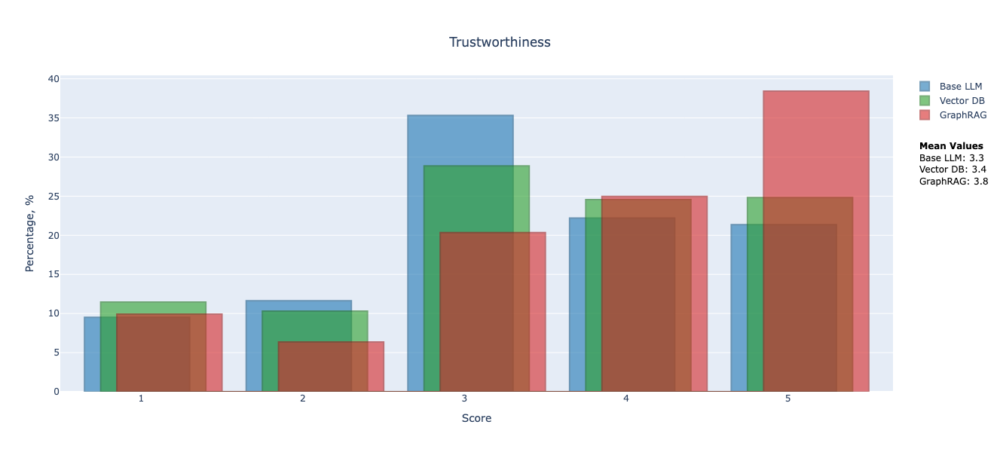

In [66]:
def make_color_darker(hex_color, factor=0.7):
    """
    Darkens the input color by reducing its lightness (l) value in the HLS color model.

    Args:
    hex_color (str): The hex code of the color.
    factor (float): The factor by which to reduce the lightness (e.g., 0.7 for a 30% darker color).

    Returns:
    str: The hex code of the darkened color.
    """
    rgb = mcolors.hex2color(hex_color)
    h, l, s = colorsys.rgb_to_hls(*rgb)
    new_rgb = colorsys.hls_to_rgb(h, max(0, l * factor), s)  # Decrease lightness
    return mcolors.to_hex(new_rgb)


# Define custom bin edges for alternating bin widths: 0.7 and 0.3
def create_variable_bin_edges(ind):
    bin_edges = [0.65 + ind*0.1]  # Start the first bin at 0.5
    for n in range(1, 10):  # Adjust for the range of integer scores (1 to 5)
        if n % 2 == 1:
            bin_edges.append(bin_edges[-1] + 0.65)  # Wider bins around integers
        else:
            bin_edges.append(bin_edges[-1] + 0.35)  # Narrower bins between integers
    return np.array(bin_edges)  # Convert to numpy array for easy manipulation
    

def plot_data_to_plot_hist_compare_configs_trustworthiness(
        df_scores_with_config_name: Dict[str, pd.DataFrame],
        metrics_name: List[str],
        not_in_column_name: List[str] = None
):
    if not_in_column_name is None:
        not_in_column_name = ["list", "_outliers", "_top_k_scores"]

    # Capitalize metric names for subplot titles
    capitalized_metrics_name = [metric.capitalize() for metric in metrics_name]

    # Create a subplot figure with one row per metric and reduced vertical spacing
    fig = make_subplots(
        rows=1, cols=1
    )

    legend_displayed = set()  # To track which models have been added to the legend

    metric_stats = {}

    for idx, df_score_config_name in enumerate(df_scores_with_config_name):
        custom_legend_name = CUSTOM_LEGEND_NAMES_MAP[df_score_config_name]
        show_legend = custom_legend_name not in legend_displayed
        if show_legend:
            legend_displayed.add(custom_legend_name)

                
        for i, metric_name in enumerate(metrics_name, start=1):
            # Extract values for the current metric
            values = np.array(df_scores_with_config_name[df_score_config_name][f"{metric_name}_scores"].tolist()).reshape(-1)
            if i == 1:
                values_tot = values
            else:
                values_tot = np.append(values_tot, values, axis=0)
 

        # Calculate histogram bin counts and edges using numpy
        # bin_counts, bin_edges = np.histogram(values, bins=np.arange(BIN_STARTS[idx], 5.5, 0.5))
        bin_counts, bin_edges = np.histogram(values_tot, bins=create_variable_bin_edges(idx))
        # to persentage
        bin_counts = (bin_counts / values_tot.shape[0]) * 100
        
        nonzero_bin_counts = bin_counts[bin_counts != 0]
        formatted_bin_counts = ["{:5.1f}".format(count) for count in nonzero_bin_counts]
        print(" ".join(formatted_bin_counts))

        # Use the bin edges to calculate bar positions and widths
        bar_x = (bin_edges[:-1] + bin_edges[1:]) / 2  # Bin centers
        bar_widths = np.diff(bin_edges)

        # Create more vivid outlines for each bin based on the fill color
        outline_color = make_color_darker(TAB_COLORS[idx % len(TAB_COLORS)], factor=0.75)

        trace = go.Bar(
            x=bar_x,
            y=bin_counts,
            name=f"{custom_legend_name}",  # Use custom names in the legend
            marker=dict(
                color=TAB_COLORS[idx % len(TAB_COLORS)],  # Use the hex colors
                line=dict(
                    color=outline_color,  # More vivid version of the fill color for the outline
                    width=2  # Outer line width
                )
            ),
            width=bar_widths,
            opacity=0.6,
            showlegend=show_legend  # Only show the legend for the first occurrence
        )
        fig.add_trace(trace, row=1, col=1)


        # Calculate statistical metrics (mean, median, quartiles)
        metric_stats[df_score_config_name] = {
            'mean': round(values_tot.mean(), 1)
        }


        
    # Prepare median text for annotation
    means = [f"{CUSTOM_LEGEND_NAMES_MAP[df_score_config_name]}: {metric_stats[df_score_config_name]['mean']}" 
               for df_score_config_name in df_scores_with_config_name]
    mean_text = "<br>".join(means)

    fig.add_annotation(
        text=f"<b>Mean Values</b><br>{mean_text}",
        xref="paper", yref="paper",
        x=1.03, y=0.80,  # Positioned outside the plot, under the legend
        xanchor="left", yanchor="top",
        showarrow=False,
        align="left",
        font=dict(size=12, color="black"),
        bordercolor=None  # Remove the rectangular border
    )

    
    fig.update_layout(
        barmode="overlay",  # Overlay histograms on the same plot
        autosize=False,
        width=1000,
        height=600,  # Adjust height based on the number of metrics
        title={
            'text': "Trustworthiness",
            'x': 0.5,  # Center the title
            'xanchor': 'center',
            'yanchor': 'top'
        },
        hovermode="closest",
        hoverlabel=dict(
            font_size=8,
            bgcolor="white",
        ),
        showlegend=True  # Enable the legend
    )
    
    
    # Set the x-axis title and range for all subplots
    fig.update_xaxes(title_text="Score", range=[0.5, 5.65])
    fig.update_yaxes(title_text="Percentage, %")

    # fig.write_image("trustworthiness_plot.png")
    
    # Show the plot
    fig.show()



plot_data_to_plot_hist_compare_configs_trustworthiness(
    df_scores_with_config_name={
        "base_llm_sys_prompt_gpt4o_mini": df_score_base_llm_sys_prompt_gpt4o_mini,
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
        "graphrag_test_gpt4o_mini": df_score_graphrag_test_gpt4o_mini,
    },
    metrics_name=[m for m in EVAL_METRIC_TOGGLE if EVAL_METRIC_TOGGLE[m] and m != "plagiarism"]
)

In [67]:
# Without consistency

plot_data_to_plot_hist_compare_configs_trustworthiness(
    df_scores_with_config_name={
        "base_llm_sys_prompt_gpt4o_mini": df_score_base_llm_sys_prompt_gpt4o_mini,
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
        "graphrag_test_gpt4o_mini": df_score_graphrag_test_gpt4o_mini,
    },
    metrics_name=[m for m in EVAL_METRIC_TOGGLE if EVAL_METRIC_TOGGLE[m] and m not in ("plagiarism", "consistency")]
)

 10.8  12.4  37.9  21.9  16.9
 11.4  10.7  31.1  25.1  21.7
  9.0   5.4  21.4  26.9  37.2


In [68]:
# PLOT mean values

def plot_mean_values(
    df_scores_with_config_name: Dict[str, pd.DataFrame],
    metrics_name: List[str],
):

    # Mean values for each configuration
    mean_values = dict()


    for cfg_name in df_scores_with_config_name:
    
        for i, metric_name in enumerate(metrics_name, start=1):
            # Extract values for the current metric
            values = np.array(df_scores_with_config_name[cfg_name][f"{metric_name}_scores"].tolist()).reshape(-1)
            if i == 1:
                values_tot = values
            else:
                values_tot = np.append(values_tot, values, axis=0)

        mean_values[cfg_name] = round(values_tot.mean(), 1)
    
    # Create the bar plot
    fig = go.Figure()
    
    for idx, config_name in enumerate(mean_values):
        mean_value_to_plot = mean_values[config_name]
        
        fig.add_trace(go.Bar(
            x=[CUSTOM_LEGEND_NAMES_MAP[config_name]],  # Use the configuration name as the x-axis label
            y=[mean_value_to_plot],   # Normalized value as the bar height (in percentage)
            name=CUSTOM_LEGEND_NAMES_MAP[config_name],  # Legend name
            marker=dict(
                color=TAB_COLORS[idx],  # Use corresponding colors
                line=dict(
                    color='black',
                    width=1.5  # Outline width
                )
            ),
            width=0.6  # Control the bar width
        ))
    
    # Update layout with centered title
    fig.update_layout(
        title={
            'text': "Trustworthiness",
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top'
        },
        xaxis_title="Configuration",
        yaxis_title="Score of Trustworthiness",
        showlegend=True,
        autosize=False,
        width=800,
        height=600
    )
    
    # Save the figure as a PNG
    # fig.write_image("mean_values_comparison.png")
    
    # Show the plot
    fig.show()


plot_mean_values(
    df_scores_with_config_name={
        "base_llm_sys_prompt_gpt4o_mini": df_score_base_llm_sys_prompt_gpt4o_mini,
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
        "graphrag_test_gpt4o_mini": df_score_graphrag_test_gpt4o_mini,
    },
    metrics_name=[m for m in EVAL_METRIC_TOGGLE if EVAL_METRIC_TOGGLE[m] and m not in ("plagiarism", "consistency")]
)

In [69]:
# PLOT mean values normalized to base

def plot_mean_values_normalized_to_base(
    df_scores_with_config_name: Dict[str, pd.DataFrame],
    metrics_name: List[str],
):

    # Mean values for each configuration
    mean_values = dict()


    for cfg_name in df_scores_with_config_name:
    
        for i, metric_name in enumerate(metrics_name, start=1):
            # Extract values for the current metric
            values = np.array(df_scores_with_config_name[cfg_name][f"{metric_name}_scores"].tolist()).reshape(-1)
            if i == 1:
                values_tot = values
            else:
                values_tot = np.append(values_tot, values, axis=0)

        mean_values[cfg_name] = round(values_tot.mean(), 1)
    
    # Normalize mean values by the first configuration (Base LLM)
    base_llm_mean = mean_values["base_llm_sys_prompt_gpt4o_mini"]
    normalized_mean_values = {mean_value_cfg_name: (mean_values[mean_value_cfg_name] / base_llm_mean) * 100 for mean_value_cfg_name in mean_values}
    
    # Create the bar plot
    fig = go.Figure()
    
    for idx, config_name in enumerate(normalized_mean_values):
        norm_value = normalized_mean_values[config_name]
        fig.add_trace(go.Bar(
            x=[CUSTOM_LEGEND_NAMES_MAP[config_name]],  # Use the configuration name as the x-axis label
            y=[norm_value],   # Normalized value as the bar height (in percentage)
            name=CUSTOM_LEGEND_NAMES_MAP[config_name],  # Legend name
            marker=dict(
                color=TAB_COLORS[idx],  # Use corresponding colors
                line=dict(
                    color='black',
                    width=1.5  # Outline width
                )
            ),
            width=0.6  # Control the bar width
        ))
    
    # Update layout with centered title and adjusted y-axis title
    fig.update_layout(
        title={
            'text': "Trustworthiness (Normalized to Base LLM)",
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top'
        },
        xaxis_title="Configuration",
        yaxis_title="Trustworthiness, %",
        showlegend=True,
        autosize=False,
        width=800,
        height=600
    )
    
    # Save the figure as a PNG
    # fig.write_image("performance_comparison_normalized.png")
    
    # Show the plot
    fig.show()


plot_mean_values_normalized_to_base(
    df_scores_with_config_name={
        "base_llm_sys_prompt_gpt4o_mini": df_score_base_llm_sys_prompt_gpt4o_mini,
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
        "graphrag_test_gpt4o_mini": df_score_graphrag_test_gpt4o_mini,
    },
    metrics_name=[m for m in EVAL_METRIC_TOGGLE if EVAL_METRIC_TOGGLE[m] and m not in ("plagiarism", "consistency")]
)

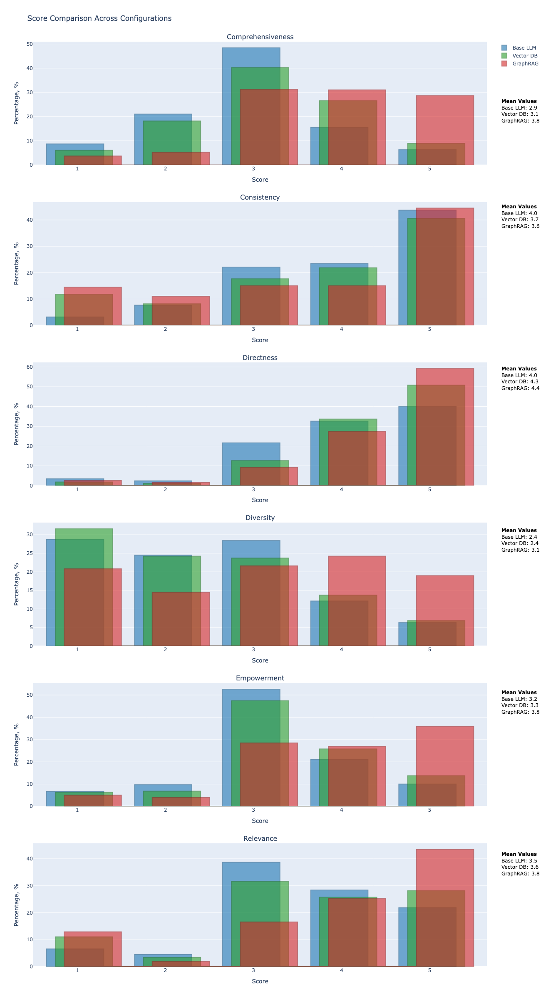

In [70]:

def make_color_darker(hex_color, factor=0.7):
    """
    Darkens the input color by reducing its lightness (l) value in the HLS color model.

    Args:
    hex_color (str): The hex code of the color.
    factor (float): The factor by which to reduce the lightness (e.g., 0.7 for a 30% darker color).

    Returns:
    str: The hex code of the darkened color.
    """
    rgb = mcolors.hex2color(hex_color)
    h, l, s = colorsys.rgb_to_hls(*rgb)
    new_rgb = colorsys.hls_to_rgb(h, max(0, l * factor), s)  # Decrease lightness
    return mcolors.to_hex(new_rgb)

def plot_data_to_plot_hist_compare_configs(
        df_scores_with_config_name: Dict[str, pd.DataFrame],
        metrics_name: List[str],
        not_in_column_name: List[str] = None
):
    if not_in_column_name is None:
        not_in_column_name = ["list", "_outliers", "_top_k_scores"]

    # Capitalize metric names for subplot titles
    capitalized_metrics_name = [metric.capitalize() for metric in metrics_name]

    # Create a subplot figure with one row per metric and reduced vertical spacing
    fig = make_subplots(
        rows=len(capitalized_metrics_name), cols=1,
        subplot_titles=capitalized_metrics_name,
        vertical_spacing=0.04  # Reduce vertical distance between plots
    )

    stats = []
    legend_displayed = set()  # To track which models have been added to the legend

    for i, metric_name in enumerate(metrics_name, start=1):
        metric_stats = {}

        # Assign different colors for each model in the plot
        for idx, df_score_config_name in enumerate(df_scores_with_config_name):
            custom_legend_name = CUSTOM_LEGEND_NAMES_MAP[df_score_config_name]
            # Extract values for the current metric
            values = np.array(df_scores_with_config_name[df_score_config_name][f"{metric_name}_scores"].tolist()).reshape(-1)

            # Determine whether to show the legend for this trace
            show_legend = custom_legend_name not in legend_displayed
            if show_legend:
                legend_displayed.add(custom_legend_name)

            # Calculate histogram bin counts and edges using numpy
            # bin_counts, bin_edges = np.histogram(values, bins=np.arange(BIN_STARTS[idx], 5.5, 0.5))
            bin_counts, bin_edges = np.histogram(values, bins=create_variable_bin_edges(idx))
            # to persentage
            bin_counts = (bin_counts / values.shape[0]) * 100

            # Use the bin edges to calculate bar positions and widths
            bar_x = (bin_edges[:-1] + bin_edges[1:]) / 2  # Bin centers
            bar_widths = np.diff(bin_edges)

            # Create more vivid outlines for each bin based on the fill color
            outline_color = make_color_darker(TAB_COLORS[idx % len(TAB_COLORS)], factor=0.75)

            # Plot bar chart manually using go.Bar
            trace = go.Bar(
                x=bar_x,
                y=bin_counts,
                name=f"{custom_legend_name}",  # Use custom names in the legend
                marker=dict(
                    color=TAB_COLORS[idx % len(TAB_COLORS)],  # Use the hex colors
                    line=dict(
                        color=outline_color,  # More vivid version of the fill color for the outline
                        width=2  # Outer line width
                    )
                ),
                width=bar_widths,
                opacity=0.6,
                showlegend=show_legend  # Only show the legend for the first occurrence
            )

            fig.add_trace(trace, row=i, col=1)

            # Calculate statistical metrics (mean, median, quartiles)
            metric_stats[df_score_config_name] = {
                'mean': round(values.mean(), 1),
                'median': round(np.percentile(values, 50), 1),
                'Q1': round(np.percentile(values, 25), 1),
                'Q2': round(np.percentile(values, 50), 1),
                'Q3': round(np.percentile(values, 75), 1),
                'Q4': round(values.max(), 1),
                'sum': round(values.sum(), 1)
            }

        # Prepare median text for annotation
        medians = [f"{CUSTOM_LEGEND_NAMES_MAP[df_score_config_name]}: {metric_stats[df_score_config_name]['mean']}" 
                   for df_score_config_name in df_scores_with_config_name]
        median_text = "<br>".join(medians)

        # For the first plot, add the median text below the legend; for others, position it outside the plot
        if i == 1:
            # For the first plot, place below the legend
            fig.add_annotation(
                text=f"<b>Mean Values</b><br>{median_text}",
                xref="paper", yref="paper",
                x=1.03, y=0.94,  # Positioned outside the plot, under the legend
                xanchor="left", yanchor="top",
                showarrow=False,
                align="left",
                font=dict(size=12, color="black"),
                bordercolor=None  # Remove the rectangular border
            )
        else:
            # For other plots, position it outside to the right
            fig.add_annotation(
                text=f"<b>Mean Values</b><br>{median_text}",
                xref="paper", yref="paper",
                x=1.03, y=(1.176 - i * 1.05 / len(metrics_name)),  # Positioned vertically along with the plots
                xanchor="left", yanchor="top",
                showarrow=False,
                align="left",
                font=dict(size=12, color="black"),
                bordercolor=None  # Remove the rectangular border
            )

        stats.append(metric_stats)

    # Update layout for better visualization
    fig.update_layout(
        barmode="overlay",  # Overlay histograms on the same plot
        autosize=False,
        width=1000,
        height=400 * len(metrics_name),  # Adjust height based on the number of metrics
        title="Score Comparison Across Configurations",
        hovermode="closest",
        hoverlabel=dict(
            font_size=8,
            bgcolor="white",
        ),
        showlegend=True  # Enable the legend
    )

    # Set the x-axis title and range for all subplots
    fig.update_xaxes(title_text="Score", range=[0.5, 5.65])
    fig.update_yaxes(title_text="Percentage, %")

    # fig.write_image("plot_output.png")
    
    # Show the plot
    fig.show()

plot_data_to_plot_hist_compare_configs(
    df_scores_with_config_name={
        "base_llm_sys_prompt_gpt4o_mini": df_score_base_llm_sys_prompt_gpt4o_mini,
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
        "graphrag_test_gpt4o_mini": df_score_graphrag_test_gpt4o_mini,
    },
    metrics_name=[m for m in EVAL_METRIC_TOGGLE if EVAL_METRIC_TOGGLE[m] and m != "plagiarism"]
)

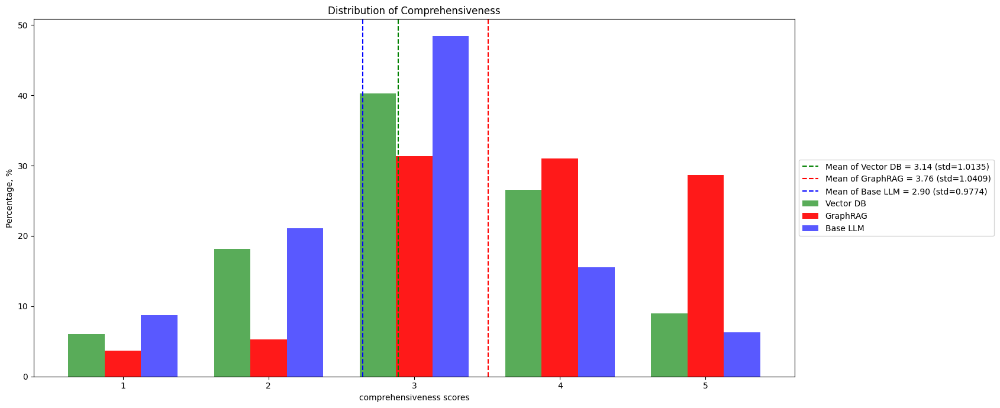

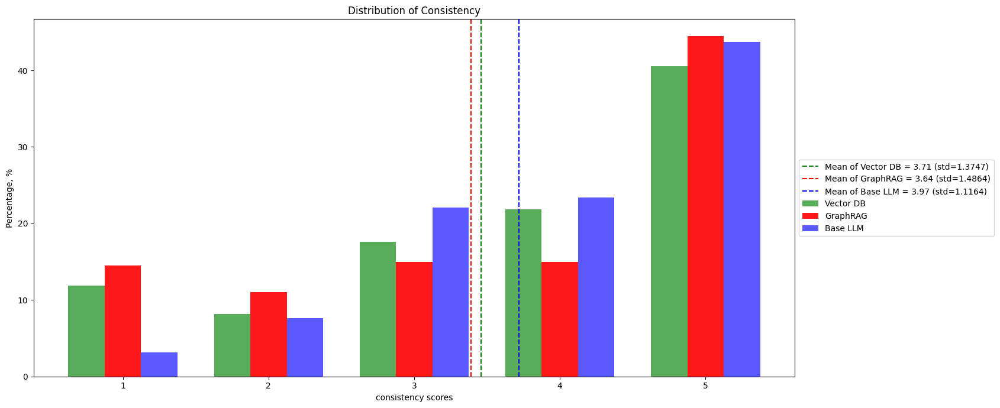

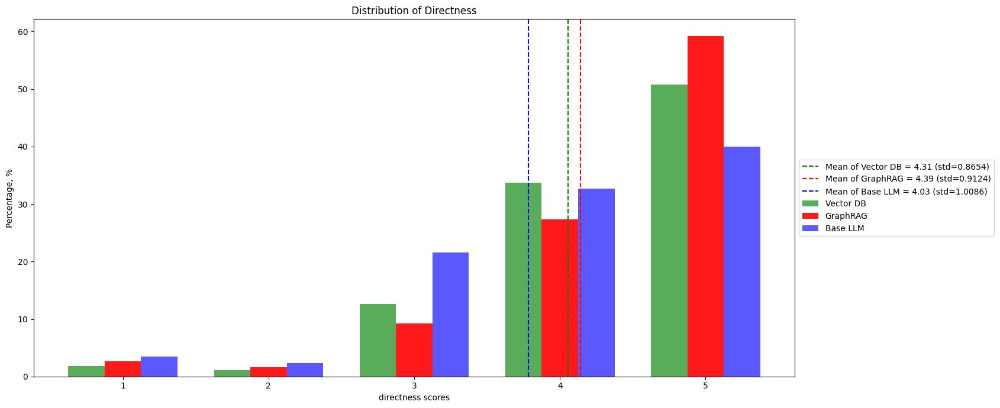

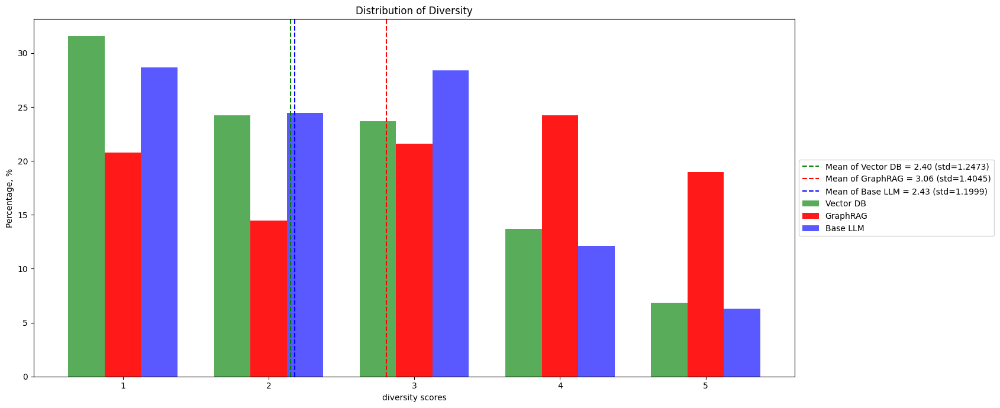

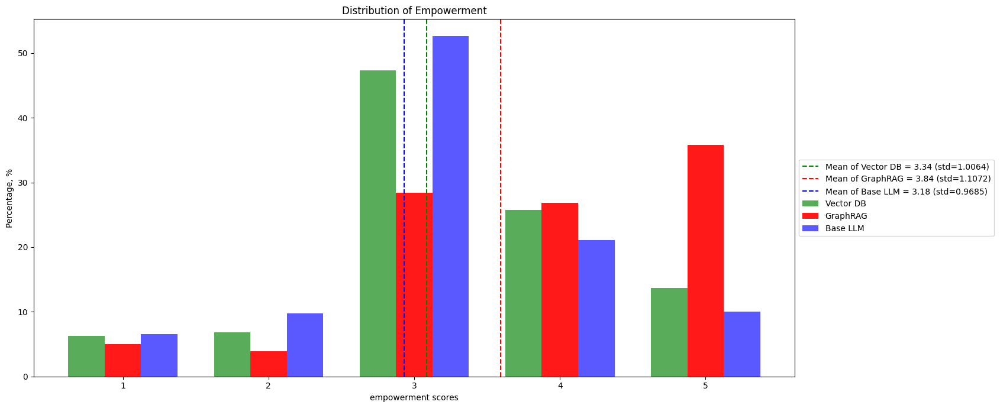

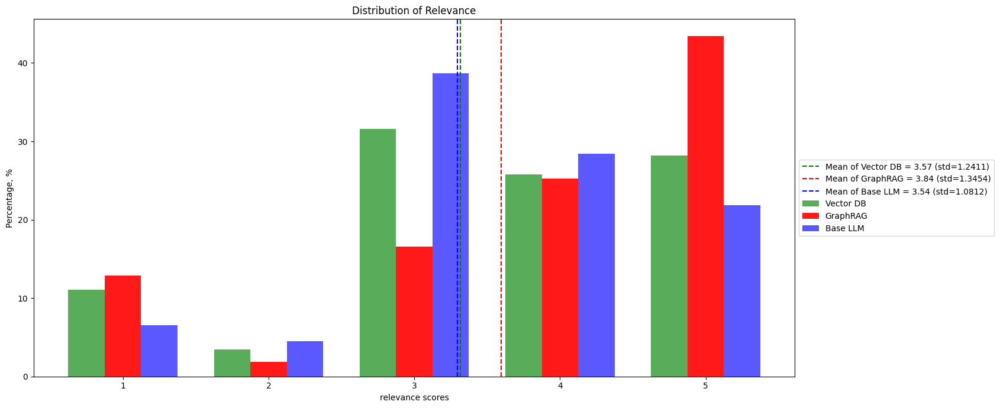

In [71]:
def plot_distribution_with_spline_interpolation(df_scores_with_config_name: dict[str, pd.DataFrame], metrics_name: list[str], bins=5):
    # Define specific colors for each dataset (3 datasets in this case)
    colors = ['green', 'red', 'blue']
    
    # Bar width for side-by-side bars
    bar_width = 0.25

    # Iterate over each metric
    for metric_name in metrics_name:
        plotted = False
        
        # Create a figure
        fig, ax_plot = plt.subplots(figsize=(20, 7))

        # Set the positions for the bars
        positions = np.arange(1, 6)  # For scores 1 to 5

        for idx, (label, data_df) in enumerate(df_scores_with_config_name.items()):
            # Flatten the data if necessary
            if f"{metric_name}_scores" in data_df.columns:
                data = np.array(data_df[f"{metric_name}_scores"].tolist()).reshape(-1)
                mean = np.mean(data)
                std = np.std(data)
                
                if not np.all(np.array(data) == None):
    
                    # Create a histogram for the current dataset
                    hist_data, bin_edges = np.histogram(data, bins=np.arange(0.5, 6.5, 1))

                    # Convert to percentage
                    hist_data = (hist_data / data.shape[0]) * 100
    
                    # Adjust the positions of the bars so they don't overlap and are side-by-side
                    adjusted_positions = positions + (bar_width * idx)
    
                    # Plot bars for each configuration with a specific color
                    alpha = 0.9 if "graphrag" in label else 0.65
                    ax_plot.bar(adjusted_positions, hist_data, width=bar_width, label=f'{CUSTOM_LEGEND_NAMES_MAP[label]}', color=colors[idx], alpha=alpha)
    
                    # Means
                    ax_plot.axvline(mean, color=colors[idx], linestyle='--', label=f'Mean of {CUSTOM_LEGEND_NAMES_MAP[label]} = {mean:.2f} (std={std:.4f})')

                    plotted = True

        if plotted:
            # Set title and labels for the plot
            ax_plot.set_title(f'Distribution of {metric_name.capitalize()}')
            ax_plot.set_xlabel(f'{metric_name} scores')
            ax_plot.set_ylabel('Percentage, %')
    
            # Set x-axis tick marks in the middle of the grouped bars
            ax_plot.set_xticks(ticks=positions + bar_width)
            ax_plot.set_xticklabels(np.arange(1, 6))

            # Move the legend to the right of the plot
            ax_plot.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
    
            # Adjust layout to avoid overlap
            plt.tight_layout(rect=[0, 0, 0.85, 1])  # Adjust the layout to make space for the legend
    
            # Show the plot
            plt.show()

# Example usage of the function
plot_distribution_with_spline_interpolation(df_scores_with_config_name={
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
        "graphrag_test_gpt4o_mini": df_score_graphrag_test_gpt4o_mini,
        "base_llm_sys_prompt_gpt4o_mini": df_score_base_llm_sys_prompt_gpt4o_mini,
    },
    metrics_name=[m for m in EVAL_METRIC_TOGGLE if EVAL_METRIC_TOGGLE[m] and m != "plagiarism"])

## Hist: Score

In [72]:
plot_data_to_plot_bar_compare_configs(
    df_scores_with_config_name={
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
        "graphrag_test_gpt4o_mini": df_score_graphrag_test_gpt4o_mini,
        # "base_llm_gpt4o_mini": df_score_base_llm_gpt4o_mini,
        "base_llm_sys_prompt_gpt4o_mini": df_score_base_llm_sys_prompt_gpt4o_mini,
    },
    metrics_name=[m for m in EVAL_METRIC_TOGGLE if EVAL_METRIC_TOGGLE[m] and m != "plagiarism"],
    plot_additional_metric="score",
    not_in_column_name=["list", "_outliers", "_top_k_scores"],
)

Statistics for comprehensiveness_score:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 3.1
Median: 3.2
Q1: 2.6
Q2: 3.2
Q3: 3.8
Q4: 4.3
Sum: 119.4


Config: graphrag_test_gpt4o_mini
Mean: 3.8
Median: 3.9
Q1: 3.2
Q2: 3.9
Q3: 4.3
Q4: 4.7
Sum: 142.8


Config: base_llm_sys_prompt_gpt4o_mini
Mean: 2.9
Median: 2.8
Q1: 2.6
Q2: 2.8
Q3: 3.2
Q4: 4.6
Sum: 110.1


Statistics for consistency_score:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 3.7
Median: 3.8
Q1: 3.4
Q2: 3.8
Q3: 4.1
Q4: 4.6
Sum: 141.0


Config: graphrag_test_gpt4o_mini
Mean: 3.6
Median: 3.8
Q1: 3.2
Q2: 3.8
Q3: 4.1
Q4: 4.8
Sum: 138.3


Config: base_llm_sys_prompt_gpt4o_mini
Mean: 4.0
Median: 4.0
Q1: 3.8
Q2: 4.0
Q3: 4.2
Q4: 4.9
Sum: 150.8


Statistics for directness_score:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 4.3
Median: 4.4
Q1: 3.9
Q2: 4.4
Q3: 4.6
Q4: 4.9
Sum: 163.6


Config: graphrag_test_gpt4o_mini
Mean: 4.4
Median: 4.6
Q1: 4.0
Q2: 4.6
Q3: 4.8
Q4: 5.0
Sum: 166.8


Config: base_llm_s

In [73]:
if EVAL_METRIC_TOGGLE["plagiarism"]:
    plot_data_to_plot_bar_compare_configs(
        df_scores_with_config_name={
            "vdb_gpt4o_mini_fixed_content_based_on_dialogs": df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
            "graphrag_test_gpt4o_mini": df_score_graphrag_test_gpt4o_mini
        },
        metrics_name=['plagiarism'],
        plot_additional_metric="score",
        not_in_column_name=["list", "_outliers", "_top_k_scores"],
    )

Statistics for plagiarism_score:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 0.6
Median: 0.6
Q1: 0.5
Q2: 0.6
Q3: 0.7
Q4: 0.9
Sum: 22.4


Config: graphrag_test_gpt4o_mini
Mean: 0.5
Median: 0.4
Q1: 0.4
Q2: 0.4
Q3: 0.5
Q4: 0.7
Sum: 17.3




## Hist: Execution time

In [74]:
plot_data_to_plot_bar_compare_configs(
    df_scores_with_config_name={
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
        "graphrag_test_gpt4o_mini": df_score_graphrag_test_gpt4o_mini,
        # "base_llm_gpt4o_mini": df_score_base_llm_gpt4o_mini,
        "base_llm_sys_prompt_gpt4o_mini": df_score_base_llm_sys_prompt_gpt4o_mini,
    },
    metrics_name=[m for m in EVAL_METRIC_TOGGLE if EVAL_METRIC_TOGGLE[m]],
    plot_additional_metric="time_exe",
    not_in_column_name=["list", "_outliers", "_top_k_scores"],
)

Statistics for comprehensiveness_time_exe:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 18.8
Median: 18.9
Q1: 17.1
Q2: 18.9
Q3: 20.0
Q4: 23.5
Sum: 712.7


Config: graphrag_test_gpt4o_mini
Mean: 20.4
Median: 19.9
Q1: 19.0
Q2: 19.9
Q3: 21.0
Q4: 40.9
Sum: 773.7


Config: base_llm_sys_prompt_gpt4o_mini
Mean: 17.8
Median: 17.5
Q1: 16.5
Q2: 17.5
Q3: 18.4
Q4: 22.3
Sum: 676.9


Statistics for consistency_time_exe:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 21.3
Median: 20.6
Q1: 20.0
Q2: 20.6
Q3: 23.3
Q4: 26.2
Sum: 811.0


Config: graphrag_test_gpt4o_mini
Mean: 22.8
Median: 22.1
Q1: 21.0
Q2: 22.1
Q3: 23.8
Q4: 32.8
Sum: 866.8


Config: base_llm_sys_prompt_gpt4o_mini
Mean: 20.9
Median: 20.8
Q1: 19.3
Q2: 20.8
Q3: 22.9
Q4: 25.5
Sum: 792.6


Statistics for directness_time_exe:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 16.9
Median: 16.8
Q1: 15.7
Q2: 16.8
Q3: 18.2
Q4: 20.4
Sum: 642.5


Config: graphrag_test_gpt4o_mini
Mean: 18.9
Median: 18.8
Q1: 17.3
Q

## Hist: Number of tokens

In [75]:
'''
plot_data_to_plot_bar(df_score=df_score_scenario_1, plot_additional_metric="total_tokens",
                      not_in_column_name=["list", "_outliers", "_top_k_scores"],
                      metrics_name=['relevance', 'consistency', 'plagiarism'],
                      )
'''
plot_data_to_plot_bar_compare_configs(
    df_scores_with_config_name={
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
        "graphrag_test_gpt4o_mini": df_score_graphrag_test_gpt4o_mini,
        # "base_llm_gpt4o_mini": df_score_base_llm_gpt4o_mini,
        "base_llm_sys_prompt_gpt4o_mini": df_score_base_llm_sys_prompt_gpt4o_mini,
    },
    metrics_name=[m for m in EVAL_METRIC_TOGGLE if EVAL_METRIC_TOGGLE[m] and m != "plagiarism"],
    plot_additional_metric="total_tokens",
    not_in_column_name=["list", "_outliers", "_top_k_scores"],
)

Statistics for comprehensiveness_total_tokens:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 24608.2
Median: 23170.0
Q1: 22579.8
Q2: 23170.0
Q3: 24962.5
Q4: 36062.0
Sum: 935112


Config: graphrag_test_gpt4o_mini
Mean: 27824.8
Median: 27454.5
Q1: 24804.5
Q2: 27454.5
Q3: 29243.5
Q4: 36864.0
Sum: 1057344


Config: base_llm_sys_prompt_gpt4o_mini
Mean: 23732.9
Median: 22737.0
Q1: 22168.2
Q2: 22737.0
Q3: 23765.2
Q4: 32382.0
Sum: 901851


Statistics for consistency_total_tokens:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 29090.3
Median: 26264.0
Q1: 25432.5
Q2: 26264.0
Q3: 29496.2
Q4: 51924.0
Sum: 1105430


Config: graphrag_test_gpt4o_mini
Mean: 35155.0
Median: 32877.0
Q1: 29663.0
Q2: 32877.0
Q3: 36643.5
Q4: 56098.0
Sum: 1335891


Config: base_llm_sys_prompt_gpt4o_mini
Mean: 27723.8
Median: 25356.0
Q1: 24291.8
Q2: 25356.0
Q3: 27800.5
Q4: 43881.0
Sum: 1053504


Statistics for directness_total_tokens:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 2359

## Hist: Std Score

In [76]:
'''
plot_data_to_plot_bar(df_score=df_score_scenario_1, plot_additional_metric="std_score",
                      not_in_column_name=["list", "_outliers", "_top_k_scores"],
                      metrics_name=['relevance', 'consistency'],
                      )
'''
plot_data_to_plot_bar_compare_configs(
    df_scores_with_config_name={
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs": df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
        "graphrag_test_gpt4o_mini": df_score_graphrag_test_gpt4o_mini,
        # "base_llm_gpt4o_mini": df_score_base_llm_gpt4o_mini,
        "base_llm_sys_prompt_gpt4o_mini": df_score_base_llm_sys_prompt_gpt4o_mini,
    },
    metrics_name=[m for m in EVAL_METRIC_TOGGLE if EVAL_METRIC_TOGGLE[m] and m != "plagiarism"],
    plot_additional_metric="std_score",
    not_in_column_name=["list", "_outliers", "_top_k_scores"],
)

Statistics for comprehensiveness_std_score:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 0.7
Median: 0.7
Q1: 0.6
Q2: 0.7
Q3: 0.9
Q4: 1.2
Sum: 28.4


Config: graphrag_test_gpt4o_mini
Mean: 0.8
Median: 0.7
Q1: 0.6
Q2: 0.7
Q3: 0.9
Q4: 1.6
Sum: 29.5


Config: base_llm_sys_prompt_gpt4o_mini
Mean: 0.7
Median: 0.6
Q1: 0.5
Q2: 0.6
Q3: 0.8
Q4: 1.2
Sum: 24.7


Statistics for consistency_std_score:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 1.2
Median: 1.3
Q1: 1.0
Q2: 1.3
Q3: 1.5
Q4: 1.9
Sum: 47.4


Config: graphrag_test_gpt4o_mini
Mean: 1.3
Median: 1.3
Q1: 1.1
Q2: 1.3
Q3: 1.6
Q4: 1.8
Sum: 49.2


Config: base_llm_sys_prompt_gpt4o_mini
Mean: 1.0
Median: 0.9
Q1: 0.8
Q2: 0.9
Q3: 1.2
Q4: 1.6
Sum: 38.2


Statistics for directness_std_score:
Config: vdb_gpt4o_mini_fixed_content_based_on_dialogs
Mean: 0.7
Median: 0.7
Q1: 0.5
Q2: 0.7
Q3: 0.8
Q4: 1.3
Sum: 27.3


Config: graphrag_test_gpt4o_mini
Mean: 0.7
Median: 0.5
Q1: 0.4
Q2: 0.5
Q3: 1.0
Q4: 1.4
Sum: 24.9


Config: base_l

In [77]:
COLOR_SCALE = ['aggrnyl', 'agsunset', 'algae', 'amp', 'armyrose', 'balance',
               'blackbody', 'bluered', 'blues', 'blugrn', 'bluyl', 'brbg',
               'brwnyl', 'bugn', 'bupu', 'burg', 'burgyl', 'cividis', 'curl',
               'darkmint', 'deep', 'delta', 'dense', 'earth', 'edge', 'electric',
               'emrld', 'fall', 'geyser', 'gnbu', 'gray', 'greens', 'greys',
               'haline', 'hot', 'hsv', 'ice', 'icefire', 'inferno', 'jet',
               'magenta', 'magma', 'matter', 'mint', 'mrybm', 'mygbm', 'oranges',
               'orrd', 'oryel', 'oxy', 'peach', 'phase', 'picnic', 'pinkyl',
               'piyg', 'plasma', 'plotly3', 'portland', 'prgn', 'pubu', 'pubugn',
               'puor', 'purd', 'purp', 'purples', 'purpor', 'rainbow', 'rdbu',
               'rdgy', 'rdpu', 'rdylbu', 'rdylgn', 'redor', 'reds', 'solar',
               'spectral', 'speed', 'sunset', 'sunsetdark', 'teal', 'tealgrn',
               'tealrose', 'tempo', 'temps', 'thermal', 'tropic', 'turbid',
               'turbo', 'twilight', 'viridis', 'ylgn', 'ylgnbu', 'ylorbr',
               'ylorrd']


## Functions

In [78]:
def calculate_difference(A, B):
    # Assert that A and B are lists
    assert isinstance(A, list) and isinstance(B, list), "A and B must be lists"
    # Assert that A and B have the same number of rows
    assert len(A) == len(B), f"A and B must have the same number of rows. Shapes are {len(A)} and {len(B)}"

    for i, (row_A, row_B) in enumerate(zip(A, B)):
        # Assert that each row in A and B has the same number of columns
        assert len(row_A) == len(
            row_B), f"Row {i} in A and B must have the same number of columns. Shapes are {len(row_A)} and {len(row_B)}"
        for j, (dict_A, dict_B) in enumerate(zip(row_A, row_B)):
            # Assert that each dictionary in A and B has the same keys
            assert set(dict_A.keys()) == set(
                dict_B.keys()), f"Dictionaries at position ({i}, {j}) in A and B must have the same keys. Keys are {set(dict_A.keys())} and {set(dict_B.keys())}"

    # Function to subtract two dictionaries
    def subtract_dicts(dict1, dict2):
        return {key: dict1[key] - dict2[key] for key in dict1}

    # Calculate the difference matrix C
    C = []
    for row_A, row_B in zip(A, B):
        row_C = [subtract_dicts(dict_A, dict_B) for dict_A, dict_B in zip(row_A, row_B)]
        C.append(row_C)

    return C


def plot_matrix_qa(x, y, z, hovertext: List[List[str]] = None, metric_name: str = "relevance",
                   colorscale: str = 'greens', zmin=None, zmax=None):
    # Round the values in z to one decimal place

    z = np.round(z, 1)

    fig = go.Figure(data=go.Heatmap(
        z=z,
        x=x,
        y=y,
        text=z,
        texttemplate="%{text}",
        hoverongaps=False,
        hovertext=hovertext,
        hoverinfo="text",
        colorscale=colorscale,
        zmin=zmin,
        zmax=zmax
    ))

    fig.update_layout(
        autosize=False,
        width=900,
        height=700,
        title=f"{metric_name}",
        xaxis_title=dict(text="Inventory", font=dict(size=12)),
        yaxis_title=dict(text="Question", font=dict(size=12)),
        hovermode="closest",
        hoverlabel=dict(
            font_size=8,
            bgcolor="white",
        ),
    )

    fig.update_xaxes(tickfont=dict(size=8))
    fig.update_yaxes(tickfont=dict(size=12))
    fig.show()


def get_x_y_z_from_df_score_to_plot_matrix(df_score,
                                           metric_name: str = "relevance",
                                           plot_additional_metric: str = "score", ):
    df_score = df_score[~pd.isna(df_score.question) & ~pd.isna(df_score.inventory)]

    x = []
    y = []
    z = []
    hover_data = []

    for question_value, df_sub in df_score.groupby("question"):
        hover_data_row = []
        z_row = []

        if question_value not in y:
            y.append(question_value)

        for inventory_value, df_sub_sub in df_sub.groupby("inventory"):

            df_score_i = df_score[df_score.inventory == inventory_value]

            z_row.append(df_sub_sub[f"{metric_name}_{plot_additional_metric}"].mean())

            hover_data_row.append(
                dict(
                    mean_q=df_sub[f"{metric_name}_{plot_additional_metric}"].mean(),
                    median_q=df_sub[f"{metric_name}_{plot_additional_metric}"].median(),
                    std_q=df_sub[f"{metric_name}_{plot_additional_metric}"].std(),
                    q1_q=df_sub[f"{metric_name}_{plot_additional_metric}"].quantile(0.25),
                    q3_q=df_sub[f"{metric_name}_{plot_additional_metric}"].quantile(0.75),
                    mean_i=df_score_i[f"{metric_name}_{plot_additional_metric}"].mean(),
                    median_i=df_score_i[f"{metric_name}_{plot_additional_metric}"].median(),
                    std_i=df_score_i[f"{metric_name}_{plot_additional_metric}"].std(),
                    q1_i=df_score_i[f"{metric_name}_{plot_additional_metric}"].quantile(0.25),
                    q3_i=df_score_i[f"{metric_name}_{plot_additional_metric}"].quantile(0.75),
                ))

            if inventory_value not in x:
                x.append(inventory_value)

        hover_data.append(hover_data_row)
        z.append(z_row)
    return x, y, z, hover_data


def format_hover_data(hover_data):
    hover_data_format = []
    for hover_data_i in range(len(hover_data)):
        hover_data_format_row = []
        for hover_data_j in range(len(hover_data[hover_data_i])):
            hover_data_format_row.append(
                "Stats_across_dialogs.groupby('inventory'):<br>mean={mean_i}<br>median={median_i}<br>std={std_i}<br>q1={q1_i}<br>q3={q3_i}<br><br>Stats_across_dialogs.groupby('question'):<br>mean={mean_q}<br>median={median_q}<br>std={std_q}<br>q1={q1_q}<br>q3={q3_q}".format(
                    mean_q=hover_data[hover_data_i][hover_data_j].get("mean_q"),
                    median_q=hover_data[hover_data_i][hover_data_j].get("median_q"),
                    std_q=hover_data[hover_data_i][hover_data_j].get("std_q"),
                    q1_q=hover_data[hover_data_i][hover_data_j].get("q1_q"),
                    q3_q=hover_data[hover_data_i][hover_data_j].get("q3_q"),
                    mean_i=hover_data[hover_data_i][hover_data_j].get("mean_i"),
                    median_i=hover_data[hover_data_i][hover_data_j].get("median_i"),
                    std_i=hover_data[hover_data_i][hover_data_j].get("std_i"),
                    q1_i=hover_data[hover_data_i][hover_data_j].get("q1_i"),
                    q3_i=hover_data[hover_data_i][hover_data_j].get("q3_i"),
                ))
        hover_data_format.append(hover_data_format_row)
    return hover_data_format


def plot_matrix_df_score(df_score,
                         metric_name: str = "relevance",
                         plot_additional_metric: str = "score",
                         colorscale: str = 'greens',
                         scale_type: ScaleType = ScaleType.scale_0_5):
    x, y, z, hover_data = get_x_y_z_from_df_score_to_plot_matrix(df_score,
                                                                 metric_name=metric_name,
                                                                 plot_additional_metric=plot_additional_metric)
    hover_data_format = format_hover_data(hover_data)

    if scale_type in scale_type_map:
        zmin, zmax = scale_type_map[scale_type]
    else:
        zmin, zmax = None, None

    plot_matrix_qa(x, y, z, hovertext=hover_data_format, metric_name=metric_name, colorscale=colorscale, zmin=zmin,
                   zmax=zmax)


def plot_matrix_df_score_diff(df_score_first, df_score_second,
                              metric_name: str = "relevance",
                              plot_additional_metric: str = "score", colorscale: str = 'rdgy',
                              scale_type: ScaleType = ScaleType.scale_minus5_5):
    x_first, y_first, z_first, hover_data_first = get_x_y_z_from_df_score_to_plot_matrix(df_score_first,
                                                                                         metric_name=metric_name,
                                                                                         plot_additional_metric=plot_additional_metric, )

    x_second, y_second, z_second, hover_data_second = get_x_y_z_from_df_score_to_plot_matrix(df_score_second,
                                                                                             metric_name=metric_name,
                                                                                             plot_additional_metric=plot_additional_metric, )

    z_first = np.array(z_first)
    z_second = np.array(z_second)
    assert z_first.shape == z_second.shape, f"z_first.shape and z_second.shape should be the same: \bz_first.shape: {z_first.shape},\nz_second.shape:{z_second.shape}"

    z_diff = z_first - z_second

    assert x_first == x_second, f"x_first and x_second should be the same: \bx_first: {x_first},\nx_second:{x_second}"
    assert y_first == y_first, f"y_first and y_first should be the same: \by_first: {y_first},\ny_first:{y_first}"

    hover_data_diff = calculate_difference(hover_data_first, hover_data_second)

    hover_data_diff = format_hover_data(hover_data_diff)

    if scale_type in scale_type_map:
        zmin, zmax = scale_type_map[scale_type]
    else:
        zmin, zmax = None, None

    plot_matrix_qa(x_first, y_first, z_diff, hovertext=hover_data_diff, metric_name=metric_name, colorscale=colorscale,
                   zmin=zmin, zmax=zmax)



## Heatmaps

In [79]:
for metric_name_heat_map in EVAL_METRIC_TOGGLE:

    if EVAL_METRIC_TOGGLE[metric_name_heat_map]:
        display(Markdown(f"### METRIC NAME: \"{metric_name_heat_map}\""))

        display(Markdown(
            f"#### [plot_matrix_df_score] df_score_graphrag_test_gpt4o_mini; METRIC NAME: \"{metric_name_heat_map}\""))
        plot_matrix_df_score(df_score_graphrag_test_gpt4o_mini,
                             metric_name=metric_name_heat_map,
                             plot_additional_metric="score",
                             scale_type=ScaleType.scale_0_5 if metric_name_heat_map != "plagiarism" else ScaleType.scale_0_1,
                             colorscale="reds" if metric_name_heat_map == "plagiarism" else "greens")

        display(Markdown(
            f"#### [plot_matrix_df_score] df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs; METRIC NAME: \"{metric_name_heat_map}\""))
        plot_matrix_df_score(df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
                             metric_name=metric_name_heat_map,
                             plot_additional_metric="score",
                             scale_type=ScaleType.scale_0_5 if metric_name_heat_map != "plagiarism" else ScaleType.scale_0_1,
                             colorscale="reds" if metric_name_heat_map == "plagiarism" else "greens")

        display(Markdown(
            f"#### [plot_matrix_df_score_diff] [ScaleType.scale_min_max] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: \"{metric_name_heat_map}\""))
        plot_matrix_df_score_diff(df_score_graphrag_test_gpt4o_mini,
                                  df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
                                  metric_name=metric_name_heat_map,
                                  plot_additional_metric="score",
                                  colorscale="rdbu" if metric_name_heat_map != "plagiarism" else "rdbu_r",
                                  scale_type=ScaleType.scale_min_max)

        display(Markdown(
            f"#### [plot_matrix_df_score_diff] [ScaleType.scale_minus5_5] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: \"{metric_name_heat_map}\""))
        plot_matrix_df_score_diff(df_score_graphrag_test_gpt4o_mini,
                                  df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs,
                                  metric_name=metric_name_heat_map,
                                  plot_additional_metric="score",
                                  colorscale="rdbu" if metric_name_heat_map != "plagiarism" else "rdbu_r",
                                  scale_type=ScaleType.scale_minus5_5 if metric_name_heat_map != "plagiarism" else ScaleType.scale_minus1_1)


### METRIC NAME: "comprehensiveness"

#### [plot_matrix_df_score] df_score_graphrag_test_gpt4o_mini; METRIC NAME: "comprehensiveness"

#### [plot_matrix_df_score] df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs; METRIC NAME: "comprehensiveness"

#### [plot_matrix_df_score_diff] [ScaleType.scale_min_max] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "comprehensiveness"

#### [plot_matrix_df_score_diff] [ScaleType.scale_minus5_5] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "comprehensiveness"

### METRIC NAME: "consistency"

#### [plot_matrix_df_score] df_score_graphrag_test_gpt4o_mini; METRIC NAME: "consistency"

#### [plot_matrix_df_score] df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs; METRIC NAME: "consistency"

#### [plot_matrix_df_score_diff] [ScaleType.scale_min_max] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "consistency"

#### [plot_matrix_df_score_diff] [ScaleType.scale_minus5_5] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "consistency"

### METRIC NAME: "directness"

#### [plot_matrix_df_score] df_score_graphrag_test_gpt4o_mini; METRIC NAME: "directness"

#### [plot_matrix_df_score] df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs; METRIC NAME: "directness"

#### [plot_matrix_df_score_diff] [ScaleType.scale_min_max] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "directness"

#### [plot_matrix_df_score_diff] [ScaleType.scale_minus5_5] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "directness"

### METRIC NAME: "diversity"

#### [plot_matrix_df_score] df_score_graphrag_test_gpt4o_mini; METRIC NAME: "diversity"

#### [plot_matrix_df_score] df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs; METRIC NAME: "diversity"

#### [plot_matrix_df_score_diff] [ScaleType.scale_min_max] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "diversity"

#### [plot_matrix_df_score_diff] [ScaleType.scale_minus5_5] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "diversity"

### METRIC NAME: "empowerment"

#### [plot_matrix_df_score] df_score_graphrag_test_gpt4o_mini; METRIC NAME: "empowerment"

#### [plot_matrix_df_score] df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs; METRIC NAME: "empowerment"

#### [plot_matrix_df_score_diff] [ScaleType.scale_min_max] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "empowerment"

#### [plot_matrix_df_score_diff] [ScaleType.scale_minus5_5] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "empowerment"

### METRIC NAME: "plagiarism"

#### [plot_matrix_df_score] df_score_graphrag_test_gpt4o_mini; METRIC NAME: "plagiarism"

#### [plot_matrix_df_score] df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs; METRIC NAME: "plagiarism"

#### [plot_matrix_df_score_diff] [ScaleType.scale_min_max] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "plagiarism"

#### [plot_matrix_df_score_diff] [ScaleType.scale_minus5_5] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "plagiarism"

### METRIC NAME: "relevance"

#### [plot_matrix_df_score] df_score_graphrag_test_gpt4o_mini; METRIC NAME: "relevance"

#### [plot_matrix_df_score] df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs; METRIC NAME: "relevance"

#### [plot_matrix_df_score_diff] [ScaleType.scale_min_max] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "relevance"

#### [plot_matrix_df_score_diff] [ScaleType.scale_minus5_5] DIFF BETWEEN `df_score_graphrag_test_gpt4o_mini` AND `df_score_vdb_gpt4o_mini_fixed_content_based_on_dialogs`; METRIC NAME: "relevance"

### Relatve Calculation

In [80]:
ENDPOINT_PROMETHEUS_EVAL = os.getenv("ENDPOINT_PROMETHEUS_EVAL")

In [81]:
from apps.agent_flow.src.eval_lib.rubrics import (
    generate_relevance_rubric_json_string,
    generate_directness_rubric_json_string,
    generate_empowerment_rubric_json_string,
    generate_diversity_rubric_json_string,
    generate_comprehensiveness_rubric_json_string,
)

In [82]:
# LLM Judge Params

times_to_eval = 2
batch_size_to_eval = 5
temperature = 0.8
max_tokens = 1024
repetition_penalty = 1.03
top_p = 0.9
best_of = 1

In [83]:
map_metric_names_to_calc_relative_to_rubric = {
    'comprehensiveness': generate_comprehensiveness_rubric_json_string(),
    # 'consistency': generate_consistency_rubric_json_string(),
    'directness': generate_directness_rubric_json_string(),
    'diversity': generate_diversity_rubric_json_string(),
    'empowerment': generate_empowerment_rubric_json_string(),
    'relevance': generate_relevance_rubric_json_string(),
}

In [84]:
get_relative_scores = False

if get_relative_scores:
    results_score_relative = {
        "graphrag_vs_base_llm_sys_prompt": dict(),
        "graphrag_vs_vdb_gpt4o_mini_fixed_content_based_on_dialogs": dict(),
        "vdb_gpt4o_mini_fixed_content_based_on_dialogs_vs_base_llm_sys_prompt": dict(),
    }
    for results_score_relative_name in results_score_relative:
        for metric_name in map_metric_names_to_calc_relative_to_rubric:
            results_score_relative[results_score_relative_name][metric_name] = []
    
    map_ab_to_cfg_name_relative_graphrag_vs_base_llm_sys_prompt = {
        "A": "graphrag_test_gpt4o_mini",
        "B": "base_llm_sys_prompt_gpt4o_mini",
    }
    map_ab_to_cfg_name_relative_graphrag_vs_vdb_gpt4o_mini_fixed_content_based_on_dialogs = {
        "A": "graphrag_test_gpt4o_mini",
        "B": "vdb_gpt4o_mini_fixed_content_based_on_dialogs",
    }
    map_ab_to_cfg_name_relative_vdb_gpt4o_mini_fixed_content_based_on_dialogs_vs_base_llm_sys_prompt = {
        "A": "vdb_gpt4o_mini_fixed_content_based_on_dialogs",
        "B": "base_llm_sys_prompt_gpt4o_mini",
    }
    
    with tqdm(total=len(results_score_relative)) as pbar_vs:
        for results_score_relative_name in results_score_relative:
            if "graphrag_vs_base_llm_sys_prompt" == results_score_relative_name:
                map_ab = map_ab_to_cfg_name_relative_graphrag_vs_base_llm_sys_prompt
                dataset_a = dataset_df_graphrag_test_gpt4o_mini
                dataset_b = dataset_df_base_llm_sys_prompt_gpt4o_mini
                
            elif "graphrag_vs_vdb_gpt4o_mini_fixed_content_based_on_dialogs" == results_score_relative_name:
                map_ab = map_ab_to_cfg_name_relative_graphrag_vs_vdb_gpt4o_mini_fixed_content_based_on_dialogs
                dataset_a = dataset_df_graphrag_test_gpt4o_mini
                dataset_b = dataset_df_vdb_gpt4o_mini_fixed_content_based_on_dialogs
                
            elif "vdb_gpt4o_mini_fixed_content_based_on_dialogs_vs_base_llm_sys_prompt" == results_score_relative_name:
                map_ab = map_ab_to_cfg_name_relative_vdb_gpt4o_mini_fixed_content_based_on_dialogs_vs_base_llm_sys_prompt
                dataset_a = dataset_df_vdb_gpt4o_mini_fixed_content_based_on_dialogs
                dataset_b = dataset_df_base_llm_sys_prompt_gpt4o_mini
    
            # Update the description dynamically for each item
            pbar_vs.set_description(f"Processing Relative Versus: {results_score_relative_name}....")
        
            for dialog_id in tqdm(range(len(dataset_a.collection.dialogs)), desc="Dialogs Processing..."):
                dialog_name = dataset_a.collection.dialogs[dialog_id].dialog_name
                
                instruction_for_all = dataset_a.collection.dialogs[dialog_id].agent_response.agent_full_executed_prompt
                response_a = dataset_a.collection.dialogs[dialog_id].agent_response.agent_answer
                response_b = dataset_b.collection.dialogs[dialog_id].agent_response.agent_answer
            
                with tqdm(total=len(map_metric_names_to_calc_relative_to_rubric)) as pbar:
                    for metric_name in map_metric_names_to_calc_relative_to_rubric:
                        
                        # Update the description dynamically for each item
                        pbar.set_description(f"Processing metric: {metric_name}....")
            
                        rubric_metric = map_metric_names_to_calc_relative_to_rubric[metric_name]
            
                        for _ in tqdm(range(times_to_eval), desc=f"Calculate metric several times..."):
                            payload = {
                                    "input": {
                                        "mode": "relative",
                                        "instruction": instruction_for_all,
                                        "response_a": response_a,
                                        "response_b": response_b,
                                        "rubric": rubric_metric,
                                        "times2judge": batch_size_to_eval,
                                        "temperature": temperature,
                                        "max_tokens": max_tokens,
                                        "repetition_penalty": repetition_penalty,
                                        "top_p": top_p,
                                        "best_of": best_of,
                                    }
                                }
                            result = send_request(data=payload, endpoint=ENDPOINT_PROMETHEUS_EVAL)
            
                            result_data = result.json()
                            scores = result_data.get("output").get("scores")
                            feedbacks = result_data.get("output").get("feedbacks")
            
                            scores_formatted = [map_ab[score] for score in scores]
            
                            results_score_relative[results_score_relative_name][metric_name].append({"dialog_name": dialog_name, "scores": scores_formatted, "feedbacks": feedbacks})
                            
            
                        pbar.update(1)
            
                if dialog_id % 5 == 0:
                    with open(f"research/{dataset_prefix}/relative_scores_all_{dataset_a.collection.collection_name}.json", "w", encoding="utf8") as f:
                        json.dump(results_score_relative, f, ensure_ascii=False, indent=2)
                    
            with open(f"research/{dataset_prefix}/relative_scores_all_{dataset_a.collection.collection_name}.json", "w", encoding="utf8") as f:
                json.dump(results_score_relative, f, ensure_ascii=False, indent=2)
            pbar_vs.update(1)


    # to csv 
    results_score_relative_table = list()
    for versus_name in results_score_relative:
        for metric_name in results_score_relative[versus_name]:
            list_of_scores = results_score_relative[versus_name][metric_name]
            for score_item in list_of_scores:
                dialog_name = score_item.get("dialog_name")
                for score, feedback in zip(score_item.get("scores"), score_item.get("feedbacks")):
                    results_score_relative_table.append({"versus_cfg": versus_name, "metric_name": metric_name, "score": score, "feedback": feedback, "dialog_name": dialog_name})
    
    results_score_relative_table = pd.DataFrame(results_score_relative_table)
    results_score_relative_table.to_csv(f"research/{dataset_prefix}/relative_scores_all_{dataset_df_graphrag_test_gpt4o_mini.collection.collection_name}.csv", index=False)

In [85]:
with open(f"research/{dataset_prefix}/relative_scores_all_{dataset_df_graphrag_test_gpt4o_mini.collection.collection_name}.json", "r", encoding="utf8") as f:
    results_score_relative = json.load(f)

In [86]:
MAP_VERSUS_NAME = {
    "graphrag_vs_base_llm_sys_prompt": "GraphRAG-vs-BaseLLM",
    "graphrag_vs_vdb_gpt4o_mini_fixed_content_based_on_dialogs": "GraphRAG-vs-VectorDB",
    "vdb_gpt4o_mini_fixed_content_based_on_dialogs_vs_base_llm_sys_prompt": "VectorDB-vs-BaseLLM",
}

results_score_relative_table = pd.read_csv(f"research/{dataset_prefix}/relative_scores_all_{dataset_df_graphrag_test_gpt4o_mini.collection.collection_name}.csv")
results_score_relative_table['versus_cfg'] = results_score_relative_table['versus_cfg'].map(MAP_VERSUS_NAME)
results_score_relative_table['score'] = results_score_relative_table['score'].map(CUSTOM_LEGEND_NAMES_MAP)

In [87]:
all_tries = results_score_relative_table[(results_score_relative_table['versus_cfg'] == next(iter(MAP_VERSUS_NAME.values()))) & (results_score_relative_table.metric_name == "comprehensiveness")].shape[0]

In [88]:
grouped_data = results_score_relative_table.groupby(['versus_cfg', 'metric_name', 'score']).size().unstack(fill_value=0)

# Reset the index to use it for plotting in Plotly
grouped_data_reset = grouped_data.reset_index()

# Melt the dataframe to long format for easier plotting with Plotly
melted_data = grouped_data_reset.melt(id_vars=['versus_cfg', 'metric_name'], var_name='score', value_name='count')
melted_data = melted_data[melted_data['count'] > 0]

In [89]:
# Create a grouped bar chart using Plotly
fig = px.bar(melted_data, 
             x='versus_cfg', 
             y='count', 
             text='count', 
             color='score', 
             facet_col='metric_name', 
             # barmode='group',
             barmode='overlay',  # Using overlay instead of group
             title='Win Counts by Configuration, Grouped by versus_cfg and metric_name',
             labels={'count': 'Win Count', 'versus_cfg': 'Versus Configuration', 'metric_name': 'Metric Name'})

# Update the layout for better visualization
fig.update_layout(
    xaxis_title='Versus Configuration',
    yaxis_title='Win Count',
    legend_title='Configuration (score)',
    bargap=0.05,
    bargroupgap=0.05,
    height=700,
    width=1200
)

fig.write_image(f"research/{dataset_prefix}/relative_scores_all_win_count_groupby_versus_cfg_and_metric_name_{dataset_df_graphrag_test_gpt4o_mini.collection.collection_name}.png")

# Show the plot
fig.show()

In [90]:
melted_data['persentage'] = round(melted_data['count'] / all_tries, 2) * 100
melted_data['persentage'] = melted_data['persentage'].apply(int)

# Create a grouped bar chart using Plotly
fig = px.bar(melted_data, 
             x='versus_cfg', 
             y='persentage', 
             text='persentage', 
             color='score', 
             facet_col='metric_name', 
             # barmode='group',
             barmode='overlay',  # Using overlay instead of group
             title='Persentage %, Wins of all tries, Grouped by versus_cfg and metric_name',
             labels={'count': 'Win Count', 'versus_cfg': 'Versus Configuration', 'metric_name': 'Metric Name'})

# Update the layout for better visualization
fig.update_layout(
    xaxis_title='Versus Configuration',
    yaxis_title='Persentage %, Wins of all tries',
    legend_title='Configuration (score)',
    bargap=0.05,
    bargroupgap=0.05,
    height=700,
    width=1200
)

fig.write_image(f"research/{dataset_prefix}/relative_scores_all_win_count_persentage_to_all_tries_groupby_versus_cfg_and_metric_name_{dataset_df_graphrag_test_gpt4o_mini.collection.collection_name}.png")

# Show the plot
fig.show()

In [91]:
# Group by both 'versus_cfg' and 'metric_name'
melted_data['min_count_in_group'] = melted_data.groupby(['versus_cfg', 'metric_name'])['count'].transform('min')

# Recalculate the percentage normalized to the lowest count in the group (versus_cfg and metric_name)
melted_data['percentage_normalized_to_lowest_one'] = (melted_data['count'] / melted_data['min_count_in_group']) * 100
melted_data['percentage_normalized_to_lowest_one'] = melted_data['percentage_normalized_to_lowest_one'].apply(round).apply(int)

# Drop the temporary 'min_count_in_group' column as it's no longer needed
melted_data = melted_data.drop(columns=['min_count_in_group'])

# Create a grouped bar chart using Plotly
fig = px.bar(melted_data, 
             x='versus_cfg', 
             y='percentage_normalized_to_lowest_one', 
             text='percentage_normalized_to_lowest_one',
             color='score', 
             facet_col='metric_name', 
             # barmode='group',
             barmode='overlay',  # Using overlay instead of group
             title='Persentage %, Normalized to lowest one, Grouped by versus_cfg and metric_name',
             labels={'count': 'Win Count', 'versus_cfg': 'Versus Configuration', 'metric_name': 'Metric Name'})

# Update the layout for better visualization
fig.update_layout(
    xaxis_title='Versus Configuration',
    yaxis_title='Persentage %, Normalized to lowest one',
    legend_title='Configuration (score)',
    bargap=0.05,
    bargroupgap=0.05,
    height=700,
    width=1200
)


# Loop through each trace and set the text position dynamically based on y-values
for i, trace in enumerate(fig.data):
    # Use conditional logic: text 'inside' if the bar height is large, otherwise 'outside'
    fig.data[i].textposition = ['outside' if y > 100 else 'inside' for y in trace.y]


fig.write_image(f"research/{dataset_prefix}/relative_scores_all_win_count_persentage_normalized_to_lowest_one_groupby_versus_cfg_and_metric_name_{dataset_df_graphrag_test_gpt4o_mini.collection.collection_name}.png")
# Show the plot
fig.show()

In [92]:
grouped_data = results_score_relative_table.groupby(['versus_cfg', 'score']).size().unstack(fill_value=0)

# Reset the index to use it for plotting in Plotly
grouped_data_reset = grouped_data.reset_index()

# Melt the dataframe to long format for easier plotting with Plotly
melted_data = grouped_data_reset.melt(id_vars=['versus_cfg'], var_name='score', value_name='count')
melted_data = melted_data[melted_data['count'] > 0]
melted_data

,versus_cfg,score,count
0,GraphRAG-vs-BaseLLM,Base LLM,350
2,VectorDB-vs-BaseLLM,Base LLM,938
3,GraphRAG-vs-BaseLLM,GraphRAG,1550
4,GraphRAG-vs-VectorDB,GraphRAG,1539
7,GraphRAG-vs-VectorDB,Vector DB,361
8,VectorDB-vs-BaseLLM,Vector DB,962


In [93]:
# Create a grouped bar chart using Plotly
fig = px.bar(melted_data, 
             x='versus_cfg', 
             y='count', 
             color='score', 
             text='count',
             # facet_col='metric_name', 
             # barmode='group',
             barmode='overlay',  # Using overlay instead of group
             title='Win Counts by Configuration, Grouped by versus_cfg ',
             labels={'count': 'Win Count', 'versus_cfg': 'Versus Configuration',})

# Update the layout for better visualization
fig.update_layout(
    xaxis_title='Versus Configuration',
    yaxis_title='Win Count',
    legend_title='Configuration (score)',
    bargap=0.05,
    bargroupgap=0.05,
    height=700,
    width=1200
)

# Loop through each trace and set the text position manually for different traces
for i, trace in enumerate(fig.data):
    if trace.name == 'Vector DB':  # Adjust this to your actual trace names or categories
        fig.data[i].textposition = 'outside'  # Set text inside for this trace
    else:
        fig.data[i].textposition = 'inside'  # Set text outside for others

fig.write_image(f"research/{dataset_prefix}/relative_scores_all_win_count_groupby_versus_cfg_{dataset_df_graphrag_test_gpt4o_mini.collection.collection_name}.png")

# Show the plot
fig.show()

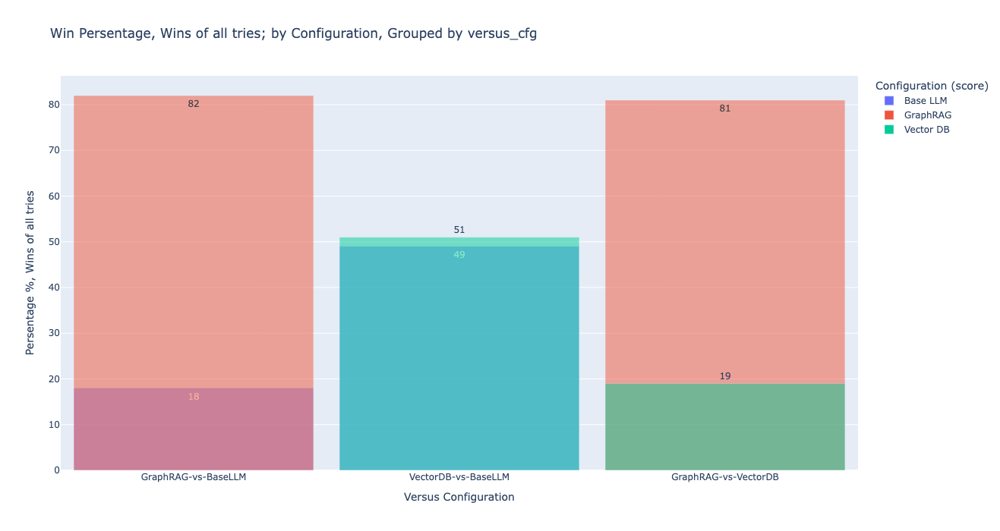

In [94]:
all_tries = results_score_relative_table[(results_score_relative_table['versus_cfg'] == next(iter(MAP_VERSUS_NAME.values())))].shape[0]

melted_data['persentage'] = round(melted_data['count'] / all_tries, 2) * 100

# Create a grouped bar chart using Plotly
fig = px.bar(melted_data, 
             x='versus_cfg', 
             y='persentage', 
             color='score', 
             text='persentage', 
             # facet_col='metric_name', 
             # barmode='group',
             barmode='overlay',  # Using overlay instead of group
             title='Win Persentage, Wins of all tries; by Configuration, Grouped by versus_cfg',
             labels={'count': 'Win Count', 'versus_cfg': 'Versus Configuration', })

# Update the layout for better visualization
fig.update_layout(
    xaxis_title='Versus Configuration',
    yaxis_title='Persentage %, Wins of all tries',
    legend_title='Configuration (score)',
    bargap=0.05,
    bargroupgap=0.05,
    height=700,
    width=1200
)


# Loop through each trace and set the text position manually for different traces
for i, trace in enumerate(fig.data):
    if trace.name == 'Vector DB':  # Adjust this to your actual trace names or categories
        fig.data[i].textposition = 'outside'  # Set text inside for this trace
    else:
        fig.data[i].textposition = 'inside'  # Set text outside for others

fig.write_image(f"research/{dataset_prefix}/relative_scores_all_win_count_persentage_to_all_tries_groupby_versus_cfg_{dataset_df_graphrag_test_gpt4o_mini.collection.collection_name}.png")

# Show the plot
fig.show()

In [95]:
# Group by both 'versus_cfg' and 'metric_name'
melted_data['min_count_in_group'] = melted_data.groupby(['versus_cfg'])['count'].transform('min')

# Recalculate the percentage normalized to the lowest count in the group (versus_cfg and metric_name)
melted_data['percentage_normalized_to_lowest_one'] = round((melted_data['count'] / melted_data['min_count_in_group']) * 100)

# Drop the temporary 'min_count_in_group' column as it's no longer needed
melted_data = melted_data.drop(columns=['min_count_in_group'])

# Create a grouped bar chart using Plotly
fig = px.bar(melted_data, 
             x='versus_cfg', 
             y='percentage_normalized_to_lowest_one', 
             color='score', 
             # facet_col='metric_name', 
             # barmode='group',
             # text_auto=True,
             text="percentage_normalized_to_lowest_one",
             barmode='overlay',  # Using overlay instead of group
             title='Persentage %, Normalized to lowest one by Configuration, Grouped by versus_cfg',
             labels={'count': 'Win Count', 'versus_cfg': 'Versus Configuration'})

# Update the layout for better visualization
fig.update_layout(
    xaxis_title='Versus Configuration',
    yaxis_title='Persentage %, Normalized to lowest one',
    legend_title='Configuration (score)',
    bargap=0.05,
    bargroupgap=0.05,
    height=700,
    width=1200
)

# Loop through each trace and set the text position manually for different traces
for i, trace in enumerate(fig.data):
    if trace.name == 'Vector DB':  # Adjust this to your actual trace names or categories
        fig.data[i].textposition = 'outside'  # Set text inside for this trace
    else:
        fig.data[i].textposition = 'inside'  # Set text outside for others

fig.write_image(f"research/{dataset_prefix}/relative_scores_all_win_count_persentage_normalized_to_lowest_one_groupby_versus_cfg_{dataset_df_graphrag_test_gpt4o_mini.collection.collection_name}.png")

# Show the plot
fig.show()